In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import sklearn
import tensorflow as tf
import pandas as pd
import seaborn as sns

import keras
from keras.models import Sequential, load_model
from keras.layers import Dense, Input
from keras.callbacks import EarlyStopping


from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score, confusion_matrix, roc_curve, auc

from imblearn.over_sampling import ADASYN
import keras_costum_metric.Balanced_accuracy as ba
import keras_costum_metric.F1metric_keras as f1
import keras_custom_callback.Early_Stop_AccLoss as Stop_AL
import keras_custom_callback.Early_Stop_AccLoss as Checkpoint_A

import Set_model 
import plot
import sampling

In [2]:
# Load the dataset
credit_df=pd.read_csv("..\\data\\german_credit.csv")
pd.set_option('display.max_columns', None)
credit_df.head(10)

,Creditability,Account Balance,Duration of Credit (month),Payment Status of Previous Credit,Purpose,Credit Amount,Value Savings/Stocks,Length of current employment,Instalment per cent,Sex & Marital Status,Guarantors,Duration in Current address,Most valuable available asset,Age (years),Concurrent Credits,Type of apartment,No of Credits at this Bank,Occupation,No of dependents,Telephone,Foreign Worker
0,1,1,18,4,2,1049,1,2,4,2,1,4,2,21,3,1,1,3,1,1,1
1,1,1,9,4,0,2799,1,3,2,3,1,2,1,36,3,1,2,3,2,1,1
2,1,2,12,2,9,841,2,4,2,2,1,4,1,23,3,1,1,2,1,1,1
3,1,1,12,4,0,2122,1,3,3,3,1,2,1,39,3,1,2,2,2,1,2
4,1,1,12,4,0,2171,1,3,4,3,1,4,2,38,1,2,2,2,1,1,2
5,1,1,10,4,0,2241,1,2,1,3,1,3,1,48,3,1,2,2,2,1,2
6,1,1,8,4,0,3398,1,4,1,3,1,4,1,39,3,2,2,2,1,1,2
7,1,1,6,4,0,1361,1,2,2,3,1,4,1,40,3,2,1,2,2,1,2
8,1,4,18,4,3,1098,1,1,4,2,1,4,3,65,3,2,2,1,1,1,1
9,1,2,24,2,3,3758,3,1,1,2,1,4,4,23,3,1,1,1,1,1,1


In [3]:
X = credit_df.drop(columns=['Creditability'])
Y = credit_df['Creditability']

In [4]:
scaler = MinMaxScaler()
scaler.fit(X)
t_X = scaler.transform(X)

In [5]:
Y = np.array(Y)


In [6]:
metrics=['accuracy', keras.metrics.Precision(), ba.BalancedAccuracy() , f1.F1Score(), keras.metrics.AUC(name='auc')]


In [7]:
loss = keras.losses.BinaryCrossentropy()


Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 23s 1s/step - accuracy: 0.5000 - auc: 0.5818 - balanced_accuracy: 0.5000 - f1_score: 0.5789 - loss: 1.0272 - precision: 0.6875
Epoch 1: val_loss improved from inf to 1.03772, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 24ms/step - accuracy: 0.4351 - auc: 0.4534 - balanced_accuracy: 0.4916 - f1_score: 0.5064 - loss: 1.0641 - precision: 0.7024 - val_accuracy: 0.4389 - val_auc: 0.3664 - val_balanced_accuracy: 0.4944 - val_f1_score: 0.5230 - val_loss: 1.0377 - val_precision: 0.6316
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.5938 - auc: 0.5893 - balanced_accuracy: 0.5000 - f1_score: 0.5269 - loss: 1.0053 - precision: 0.6316
Epoch 2: val_loss improved from 1.03772 to 1.01578, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5123 - auc: 0.4857 - balanced_accuracy: 0.4940 - f1_score: 0.5365 - loss: 1.0338 - precision: 0.6940 - val_accuracy: 0.5722 - val_au

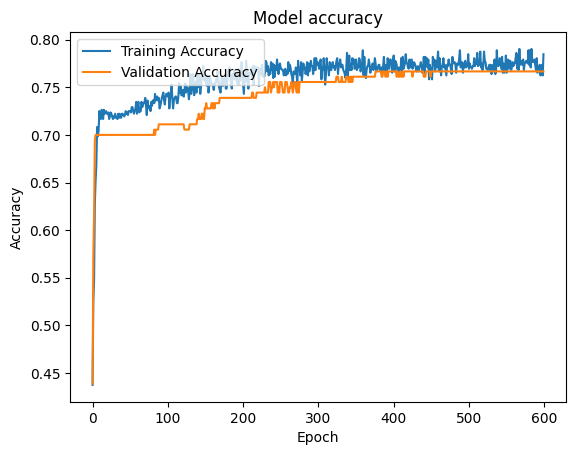

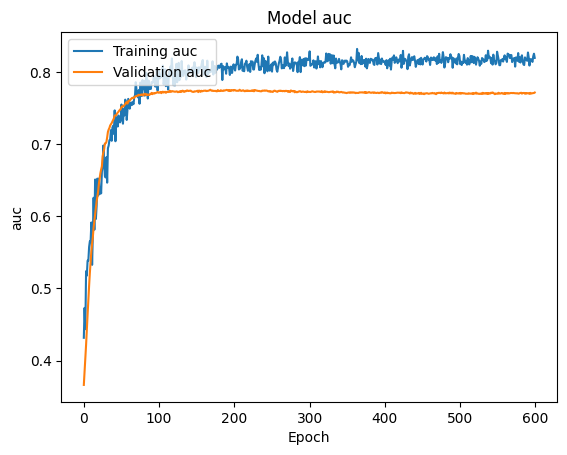

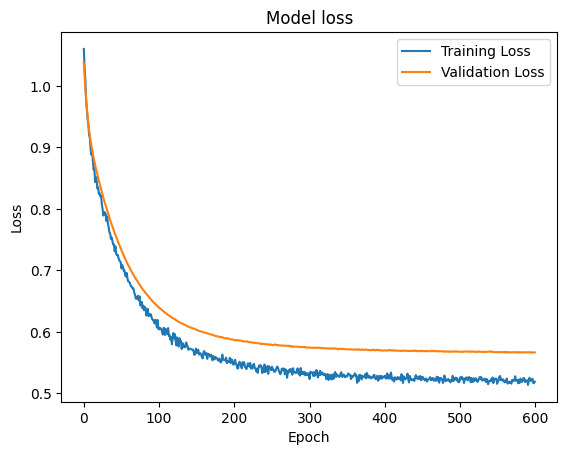

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 27s 1s/step - accuracy: 0.2812 - auc: 0.6880 - balanced_accuracy: 0.4887 - f1_score: 0.8490 - loss: 1.7594 - precision: 0.7640
Epoch 1: val_loss improved from inf to 1.50369, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - accuracy: 0.3284 - auc: 0.5328 - balanced_accuracy: 0.5008 - f1_score: 0.8489 - loss: 1.6230 - precision: 0.7190 - val_accuracy: 0.3000 - val_auc: 0.4910 - val_balanced_accuracy: 0.5000 - val_f1_score: 0.8485 - val_loss: 1.5037 - val_precision: 0.0000e+00
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step - accuracy: 0.3750 - auc: 0.4571 - balanced_accuracy: 0.5000 - f1_score: 0.8484 - loss: 1.5650 - precision: 0.8571
Epoch 2: val_loss improved from 1.50369 to 1.45626, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3765 - auc: 0.4945 - balanced_accuracy: 0.4985 - f1_score: 0.8483 - loss: 1.5302 - precision: 0.7243 - val_accuracy: 0.3000 - va

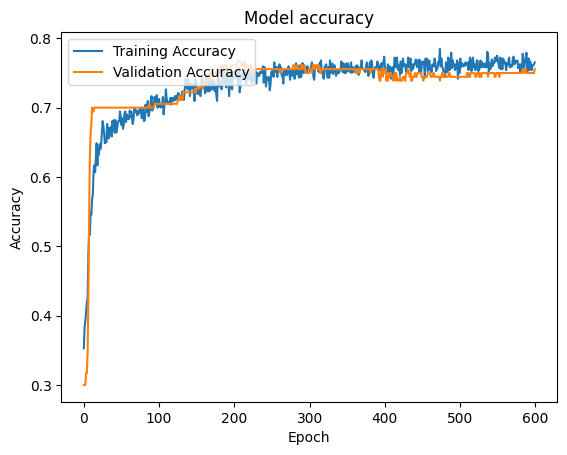

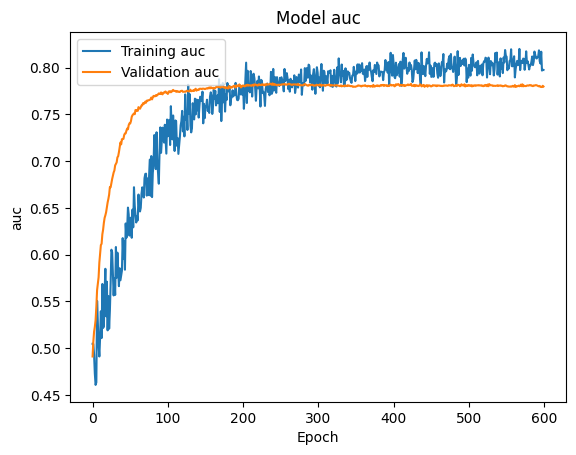

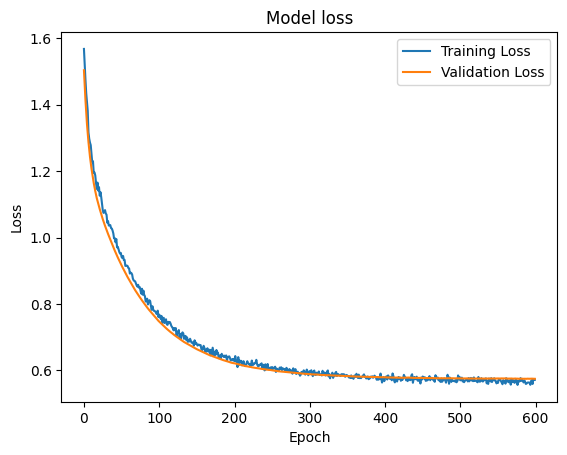

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 22s 1s/step - accuracy: 0.7188 - auc: 0.7784 - balanced_accuracy: 0.5016 - f1_score: 0.8386 - loss: 0.8622 - precision: 0.7500
Epoch 1: val_loss improved from inf to 0.91459, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.6770 - auc: 0.6457 - balanced_accuracy: 0.5029 - f1_score: 0.8386 - loss: 0.9185 - precision: 0.7143 - val_accuracy: 0.6833 - val_auc: 0.5209 - val_balanced_accuracy: 0.5058 - val_f1_score: 0.8386 - val_loss: 0.9146 - val_precision: 0.7018
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - accuracy: 0.6250 - auc: 0.4229 - balanced_accuracy: 0.5000 - f1_score: 0.8386 - loss: 0.9149 - precision: 0.7407
Epoch 2: val_loss improved from 0.91459 to 0.90769, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6798 - auc: 0.5358 - balanced_accuracy: 0.4981 - f1_score: 0.8386 - loss: 0.9033 - precision: 0.7197 - val_accuracy: 0.6944 - val_au

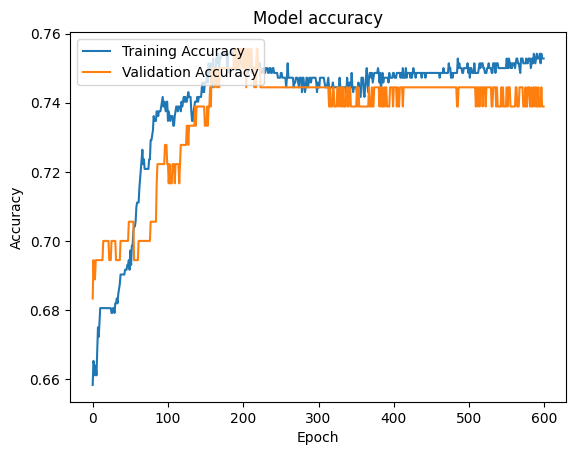

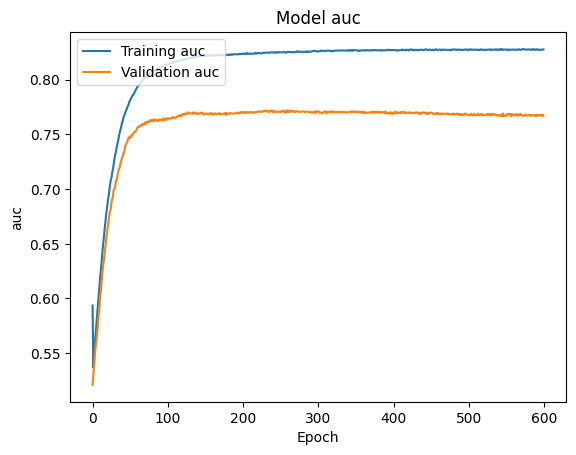

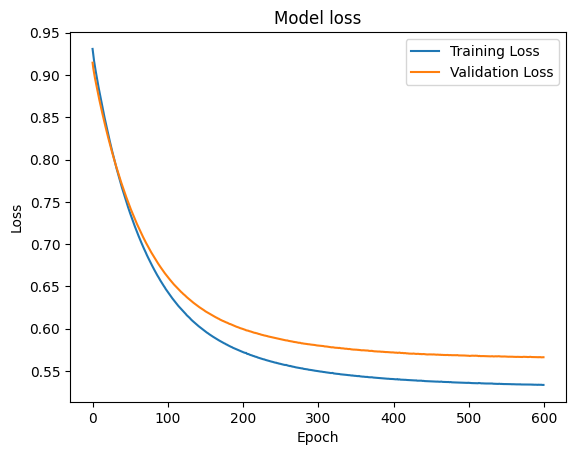

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 25s 1s/step - accuracy: 0.5625 - auc: 0.7309 - balanced_accuracy: 0.4990 - f1_score: 0.8348 - loss: 0.9647 - precision: 0.7651
Epoch 1: val_loss improved from inf to 0.95185, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.4572 - auc: 0.5778 - balanced_accuracy: 0.4995 - f1_score: 0.8348 - loss: 1.0545 - precision: 0.7156 - val_accuracy: 0.5333 - val_auc: 0.5200 - val_balanced_accuracy: 0.5008 - val_f1_score: 0.8347 - val_loss: 0.9518 - val_precision: 0.7561
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.4688 - auc: 0.3814 - balanced_accuracy: 0.5000 - f1_score: 0.8347 - loss: 1.0251 - precision: 0.7647
Epoch 2: val_loss improved from 0.95185 to 0.91696, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4935 - auc: 0.4589 - balanced_accuracy: 0.4988 - f1_score: 0.8347 - loss: 0.9985 - precision: 0.6863 - val_accuracy: 0.5833 - val_au

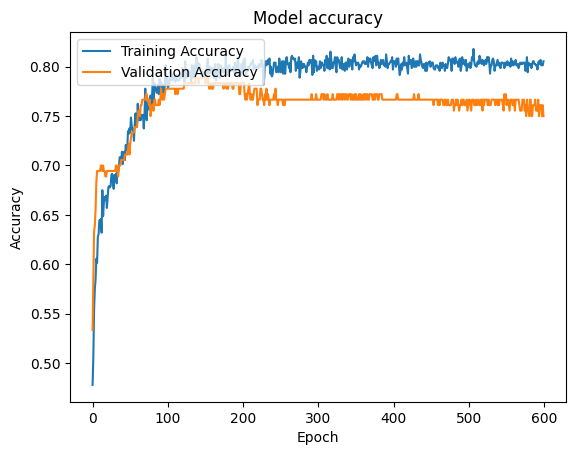

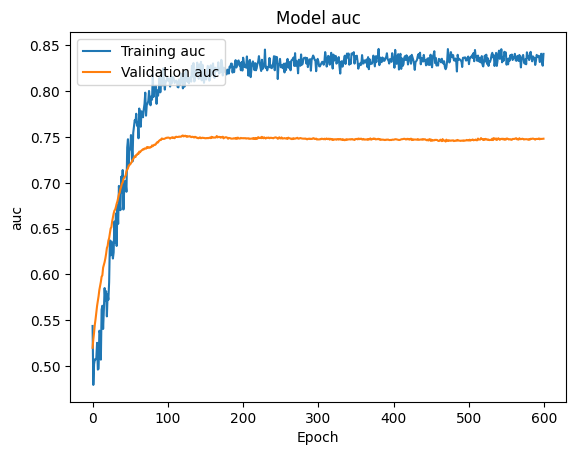

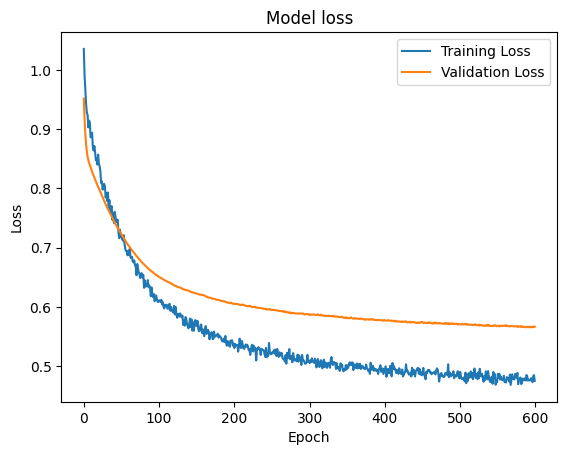

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
1/4 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/stepWARNING:tensorflow:6 out of the last 12 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x000001C1955736A0> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
Averaging Probabilities Accuracy: 0.74
Averaging Probabilities AUC: 0.78047619047619

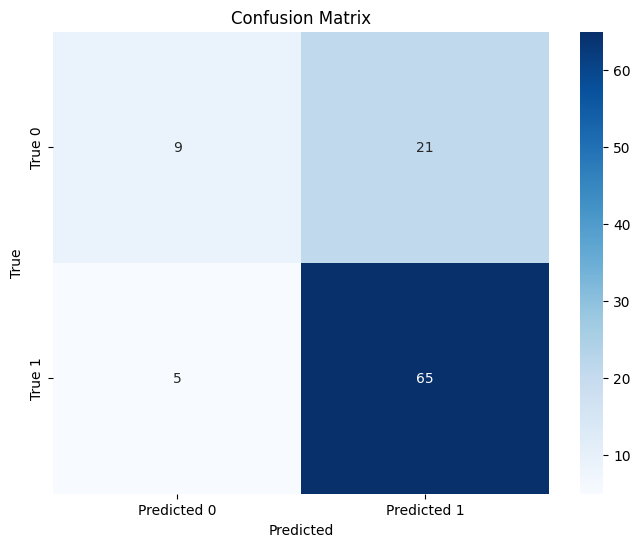

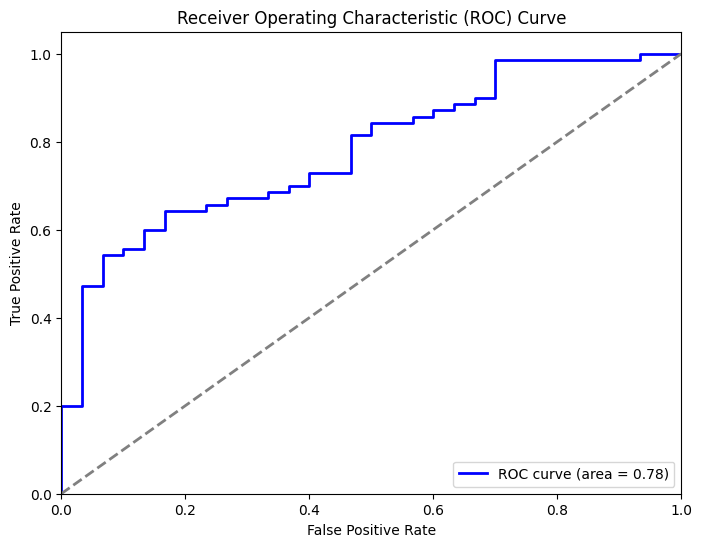

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 23s 1s/step - accuracy: 0.2500 - auc: 0.7128 - balanced_accuracy: 0.4893 - f1_score: 0.8387 - loss: 1.1043 - precision: 0.7943
Epoch 1: val_loss improved from inf to 1.03047, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.4609 - auc: 0.6431 - balanced_accuracy: 0.5051 - f1_score: 0.8386 - loss: 1.0549 - precision: 0.7784 - val_accuracy: 0.4111 - val_auc: 0.5917 - val_balanced_accuracy: 0.5034 - val_f1_score: 0.8386 - val_loss: 1.0305 - val_precision: 0.7083
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - accuracy: 0.4062 - auc: 0.3615 - balanced_accuracy: 0.5000 - f1_score: 0.8386 - loss: 1.0782 - precision: 0.5833
Epoch 2: val_loss improved from 1.03047 to 1.00618, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4491 - auc: 0.4664 - balanced_accuracy: 0.5003 - f1_score: 0.8385 - loss: 1.0531 - precision: 0.7092 - val_accuracy: 0.5500 - val_au

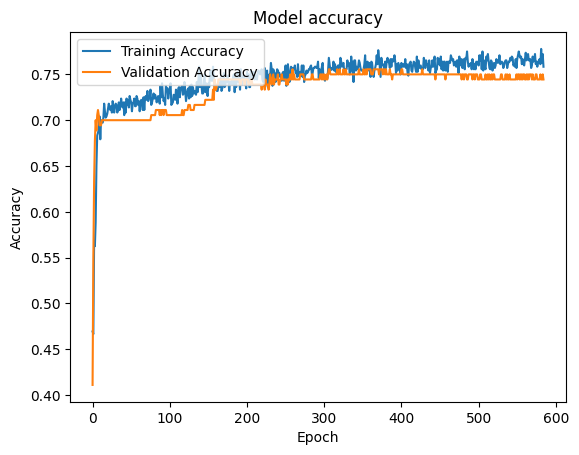

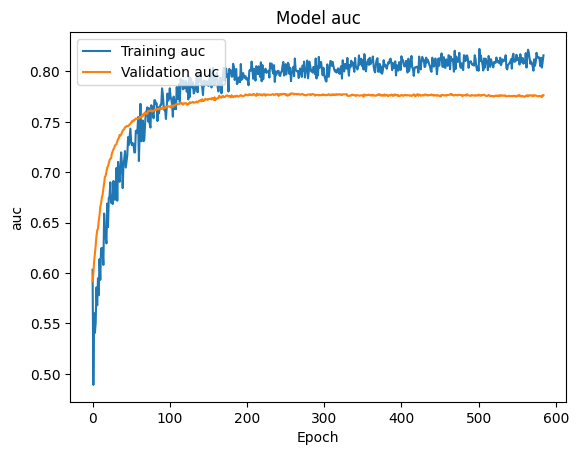

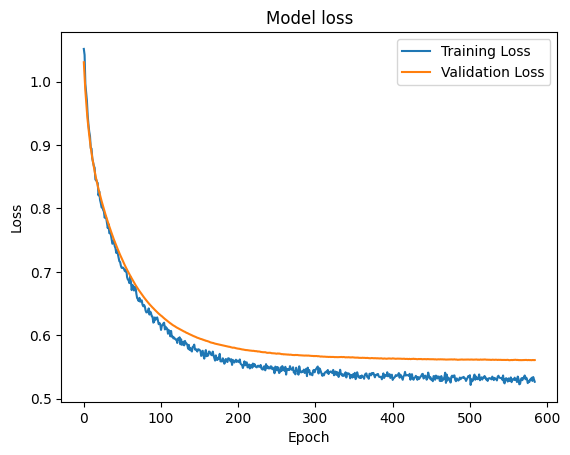

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - accuracy: 0.7500 - auc: 0.7500 - balanced_accuracy: 0.5089 - f1_score: 0.8390 - loss: 1.2515 - precision: 0.7654
Epoch 1: val_loss improved from inf to 1.28031, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.6478 - auc: 0.6144 - balanced_accuracy: 0.5021 - f1_score: 0.8390 - loss: 1.2748 - precision: 0.7413 - val_accuracy: 0.7000 - val_auc: 0.4216 - val_balanced_accuracy: 0.5000 - val_f1_score: 0.8390 - val_loss: 1.2803 - val_precision: 0.7000
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.5938 - auc: 0.4629 - balanced_accuracy: 0.5000 - f1_score: 0.8390 - loss: 1.2555 - precision: 0.7308
Epoch 2: val_loss improved from 1.28031 to 1.26426, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6068 - auc: 0.4684 - balanced_accuracy: 0.4976 - f1_score: 0.8390 - loss: 1.2859 - precision: 0.6823 - val_accuracy: 0.7000 - val_au

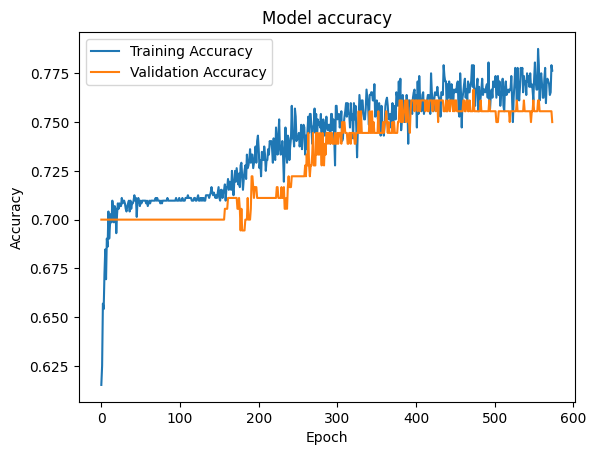

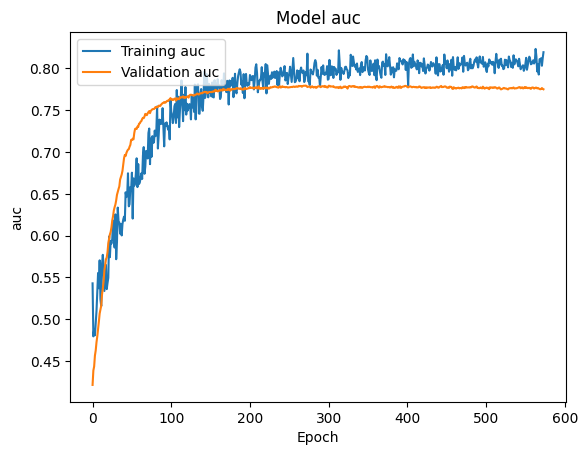

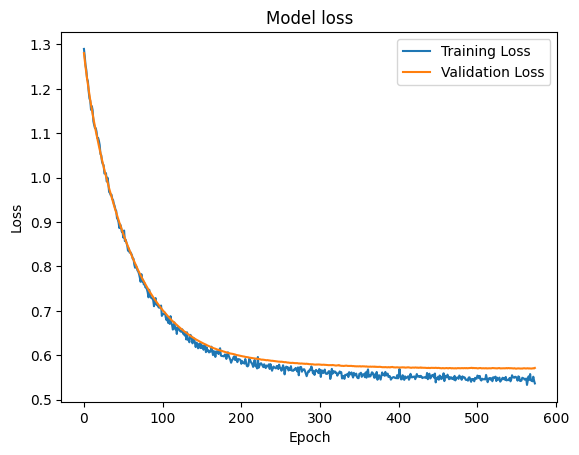

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 21s 955ms/step - accuracy: 0.7500 - auc: 0.7439 - balanced_accuracy: 0.5073 - f1_score: 0.8390 - loss: 0.8722 - precision: 0.7680
Epoch 1: val_loss improved from inf to 0.87391, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.7362 - auc: 0.6017 - balanced_accuracy: 0.5058 - f1_score: 0.8390 - loss: 0.8642 - precision: 0.7521 - val_accuracy: 0.7000 - val_auc: 0.5601 - val_balanced_accuracy: 0.5000 - val_f1_score: 0.8390 - val_loss: 0.8739 - val_precision: 0.7000
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.7188 - auc: 0.6691 - balanced_accuracy: 0.5000 - f1_score: 0.8390 - loss: 0.8588 - precision: 0.7188
Epoch 2: val_loss improved from 0.87391 to 0.87020, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7373 - auc: 0.5089 - balanced_accuracy: 0.5002 - f1_score: 0.8390 - loss: 0.8516 - precision: 0.7403 - val_accuracy: 0.7000 - val

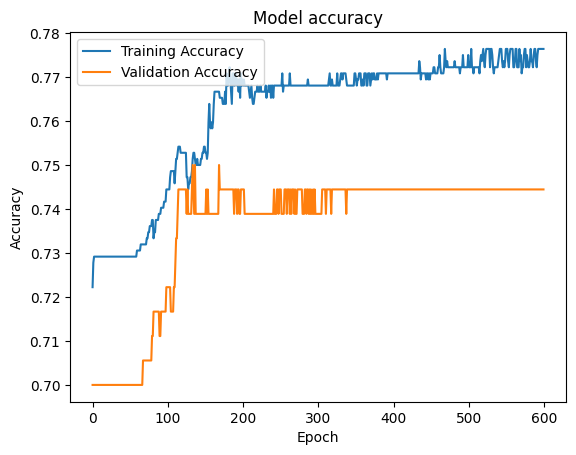

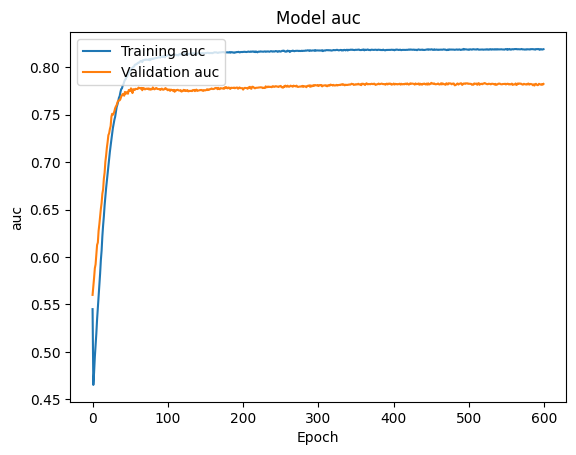

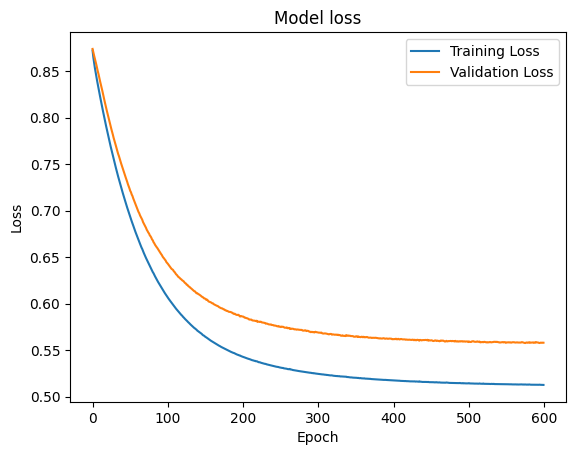

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 24s 1s/step - accuracy: 0.4375 - auc: 0.7347 - balanced_accuracy: 0.5278 - f1_score: 0.8407 - loss: 1.0948 - precision: 0.7682
Epoch 1: val_loss improved from inf to 1.01714, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.3608 - auc: 0.5874 - balanced_accuracy: 0.5129 - f1_score: 0.8407 - loss: 1.0819 - precision: 0.7557 - val_accuracy: 0.3000 - val_auc: 0.6867 - val_balanced_accuracy: 0.4984 - val_f1_score: 0.8406 - val_loss: 1.0171 - val_precision: 0.5000
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.4688 - auc: 0.5508 - balanced_accuracy: 0.5000 - f1_score: 0.8406 - loss: 0.9805 - precision: 0.3333
Epoch 2: val_loss improved from 1.01714 to 0.98462, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3972 - auc: 0.5737 - balanced_accuracy: 0.5025 - f1_score: 0.8406 - loss: 1.0175 - precision: 0.7127 - val_accuracy: 0.3333 - val_au

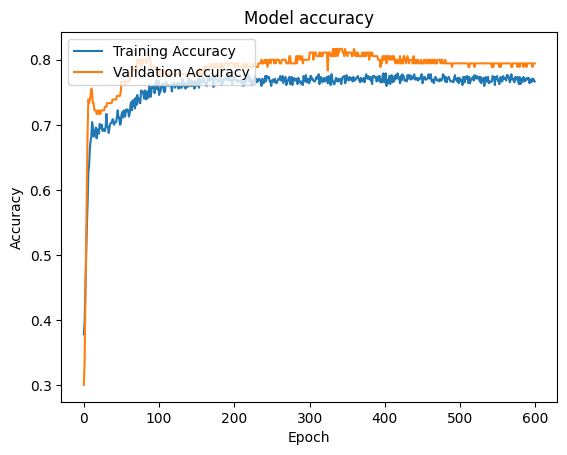

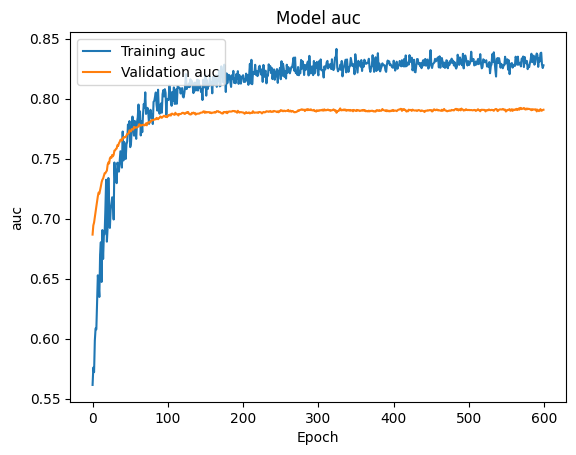

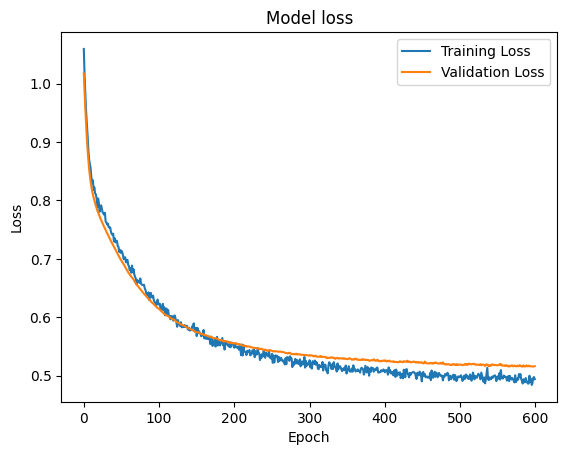

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
Averaging Probabilities Accuracy: 0.76
Averaging Probabilities AUC: 0.7219047619047619
Averaging Probabilities F1 Score: 0.8461538461538461


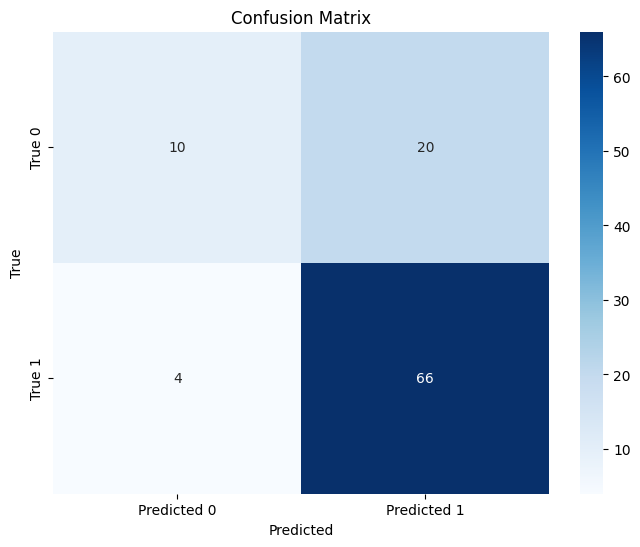

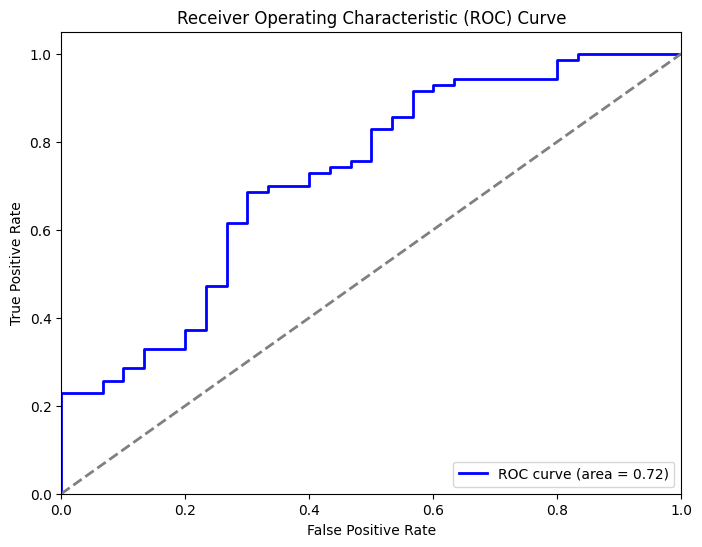

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 28s 1s/step - accuracy: 0.7500 - auc: 0.7697 - balanced_accuracy: 0.5025 - f1_score: 0.8403 - loss: 0.9643 - precision: 0.8452
Epoch 1: val_loss improved from inf to 0.96462, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.5868 - auc: 0.6542 - balanced_accuracy: 0.5006 - f1_score: 0.8403 - loss: 0.9922 - precision: 0.7634 - val_accuracy: 0.6611 - val_auc: 0.5694 - val_balanced_accuracy: 0.5045 - val_f1_score: 0.8403 - val_loss: 0.9646 - val_precision: 0.7070
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - accuracy: 0.6562 - auc: 0.5483 - balanced_accuracy: 0.5000 - f1_score: 0.8403 - loss: 0.9618 - precision: 0.7500
Epoch 2: val_loss improved from 0.96462 to 0.94957, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6167 - auc: 0.5472 - balanced_accuracy: 0.5000 - f1_score: 0.8403 - loss: 0.9763 - precision: 0.7120 - val_accuracy: 0.7000 - val_au

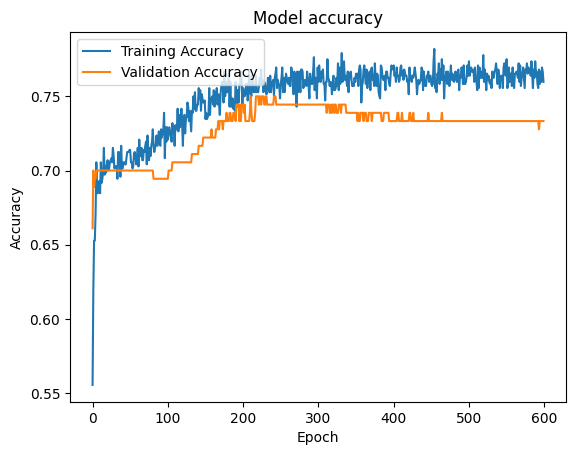

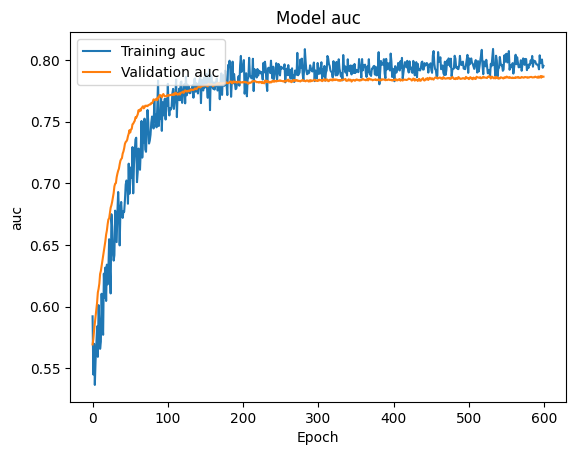

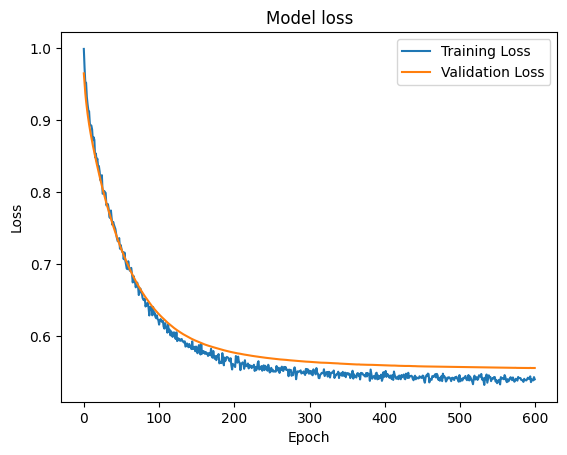

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 26s 1s/step - accuracy: 0.4062 - auc: 0.7170 - balanced_accuracy: 0.4867 - f1_score: 0.8403 - loss: 1.3704 - precision: 0.7530
Epoch 1: val_loss improved from inf to 1.34445, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.4286 - auc: 0.5963 - balanced_accuracy: 0.4985 - f1_score: 0.8403 - loss: 1.3687 - precision: 0.7241 - val_accuracy: 0.4056 - val_auc: 0.5301 - val_balanced_accuracy: 0.4990 - val_f1_score: 0.8403 - val_loss: 1.3444 - val_precision: 0.7436
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.4375 - auc: 0.4371 - balanced_accuracy: 0.5000 - f1_score: 0.8403 - loss: 1.3911 - precision: 0.7692
Epoch 2: val_loss improved from 1.34445 to 1.32113, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4799 - auc: 0.5321 - balanced_accuracy: 0.4990 - f1_score: 0.8403 - loss: 1.3502 - precision: 0.7206 - val_accuracy: 0.5000 - val_au

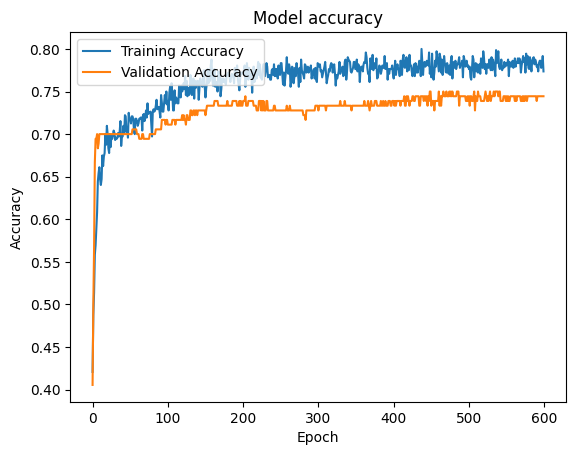

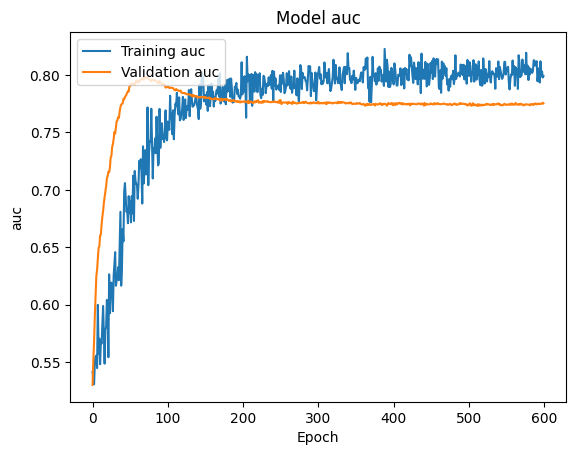

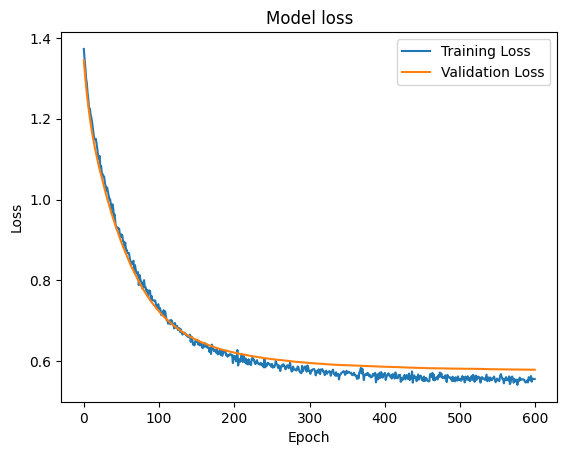

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 20s 946ms/step - accuracy: 0.3125 - auc: 0.7123 - balanced_accuracy: 0.4967 - f1_score: 0.8403 - loss: 1.0732 - precision: 0.7613
Epoch 1: val_loss improved from inf to 1.00539, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4300 - auc: 0.6212 - balanced_accuracy: 0.5082 - f1_score: 0.8403 - loss: 1.0103 - precision: 0.7760 - val_accuracy: 0.3889 - val_auc: 0.5213 - val_balanced_accuracy: 0.4977 - val_f1_score: 0.8403 - val_loss: 1.0054 - val_precision: 0.7105
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.4062 - auc: 0.4157 - balanced_accuracy: 0.5000 - f1_score: 0.8403 - loss: 1.0003 - precision: 0.3750
Epoch 2: val_loss improved from 1.00539 to 0.97105, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4619 - auc: 0.5917 - balanced_accuracy: 0.5035 - f1_score: 0.8403 - loss: 0.9778 - precision: 0.7459 - val_accuracy: 0.5111 - val

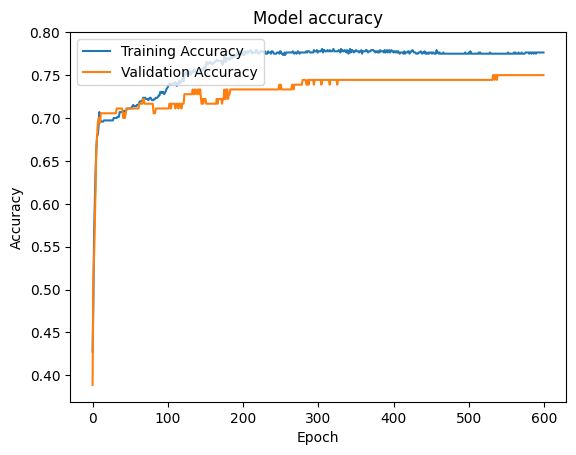

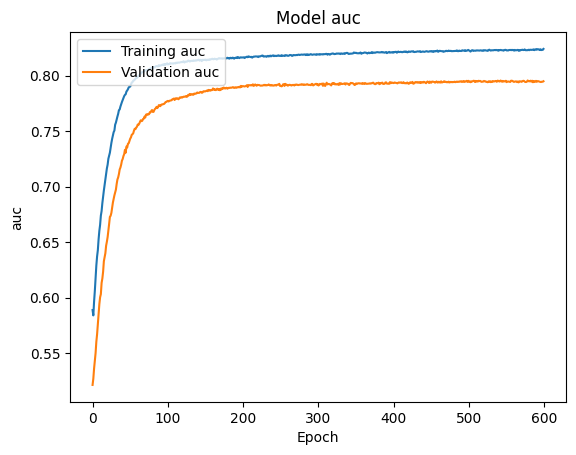

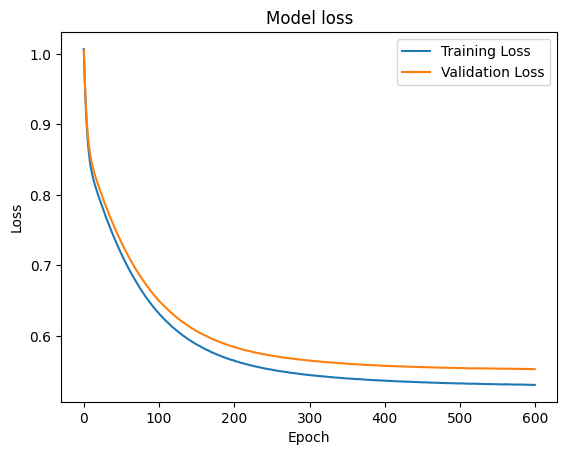

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 24s 1s/step - accuracy: 0.5312 - auc: 0.7451 - balanced_accuracy: 0.4957 - f1_score: 0.8405 - loss: 0.9406 - precision: 0.7647
Epoch 1: val_loss improved from inf to 0.88573, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - accuracy: 0.5601 - auc: 0.6257 - balanced_accuracy: 0.4996 - f1_score: 0.8405 - loss: 0.9324 - precision: 0.7406 - val_accuracy: 0.6778 - val_auc: 0.6171 - val_balanced_accuracy: 0.5030 - val_f1_score: 0.8405 - val_loss: 0.8857 - val_precision: 0.7429
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.6562 - auc: 0.5758 - balanced_accuracy: 0.5000 - f1_score: 0.8405 - loss: 0.9210 - precision: 0.7083
Epoch 2: val_loss improved from 0.88573 to 0.86756, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5890 - auc: 0.5646 - balanced_accuracy: 0.5046 - f1_score: 0.8405 - loss: 0.9105 - precision: 0.6868 - val_accuracy: 0.6889 - val_au

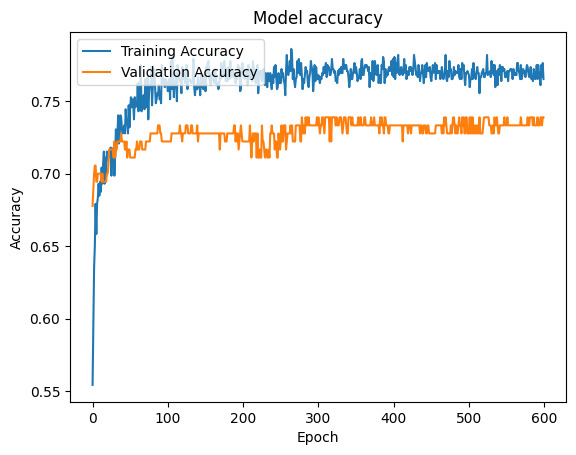

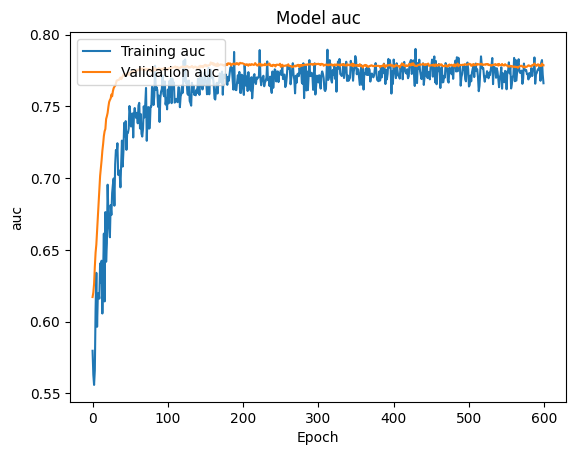

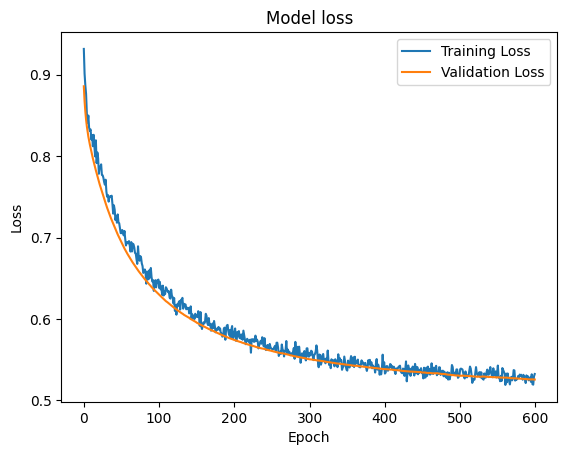

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
Averaging Probabilities Accuracy: 0.75
Averaging Probabilities AUC: 0.759047619047619
Averaging Probabilities F1 Score: 0.8322147651006712


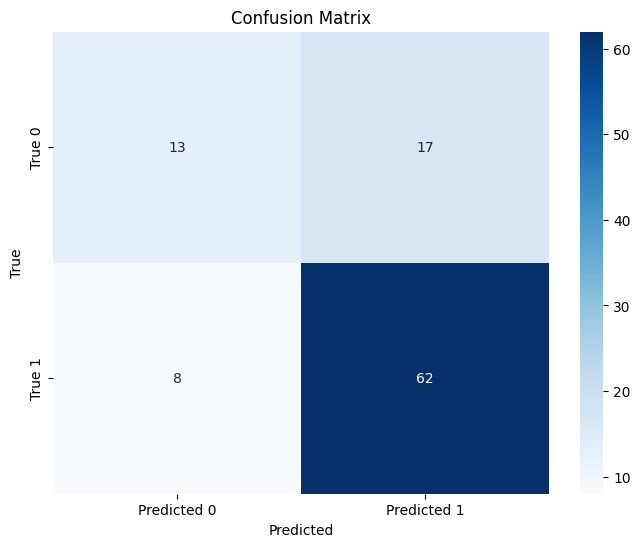

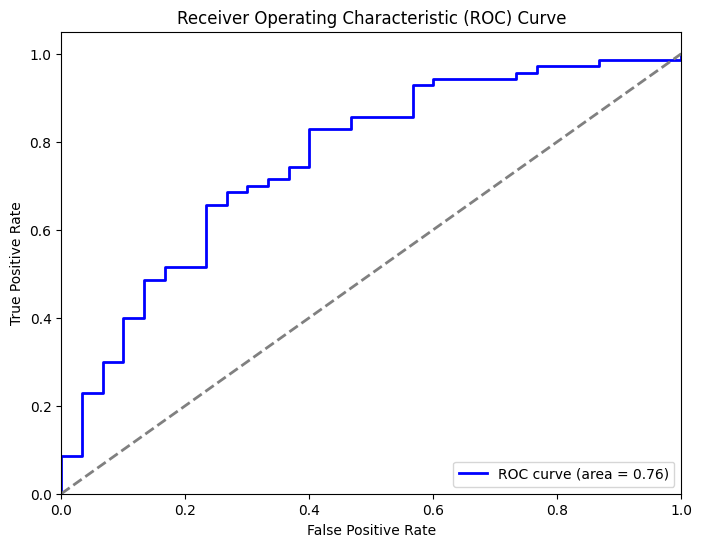

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 21s 978ms/step - accuracy: 0.5000 - auc: 0.7411 - balanced_accuracy: 0.5019 - f1_score: 0.8404 - loss: 1.0016 - precision: 0.7607
Epoch 1: val_loss improved from inf to 1.01491, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.4674 - auc: 0.6157 - balanced_accuracy: 0.5069 - f1_score: 0.8404 - loss: 1.0320 - precision: 0.7147 - val_accuracy: 0.5222 - val_auc: 0.5191 - val_balanced_accuracy: 0.5091 - val_f1_score: 0.8404 - val_loss: 1.0149 - val_precision: 0.6852
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.5000 - auc: 0.4977 - balanced_accuracy: 0.5000 - f1_score: 0.8404 - loss: 1.0262 - precision: 0.6500
Epoch 2: val_loss improved from 1.01491 to 0.99402, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5355 - auc: 0.5032 - balanced_accuracy: 0.5033 - f1_score: 0.8404 - loss: 1.0152 - precision: 0.6813 - val_accuracy: 0.6222 - val

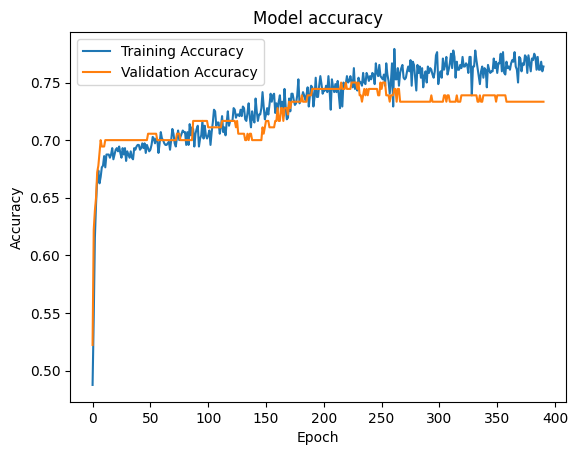

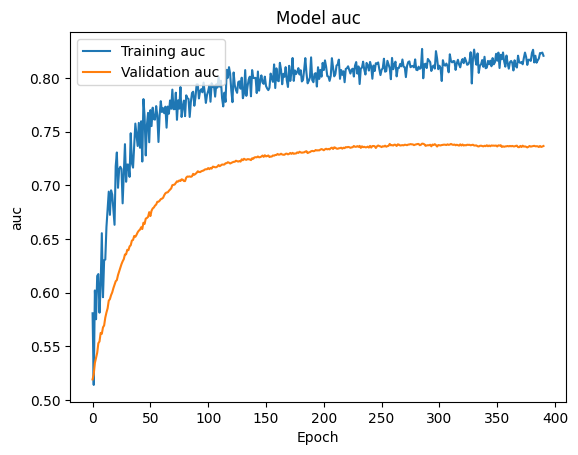

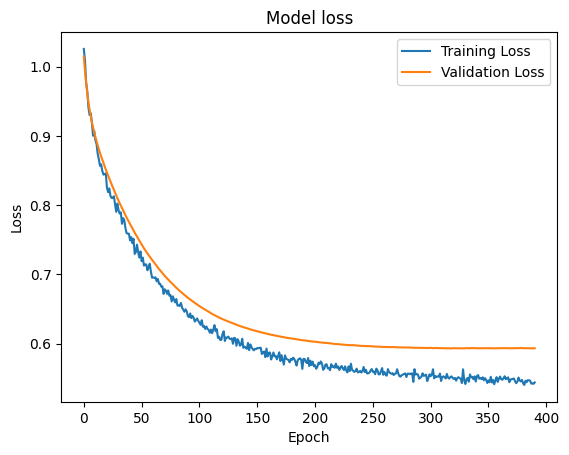

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 27s 1s/step - accuracy: 0.3750 - auc: 0.6937 - balanced_accuracy: 0.5082 - f1_score: 0.8398 - loss: 1.4674 - precision: 0.7740
Epoch 1: val_loss improved from inf to 1.36330, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.3926 - auc: 0.5796 - balanced_accuracy: 0.4991 - f1_score: 0.8398 - loss: 1.4744 - precision: 0.7742 - val_accuracy: 0.3167 - val_auc: 0.5968 - val_balanced_accuracy: 0.5019 - val_f1_score: 0.8398 - val_loss: 1.3633 - val_precision: 1.0000
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.4375 - auc: 0.5078 - balanced_accuracy: 0.5000 - f1_score: 0.8398 - loss: 1.4358 - precision: 0.8000
Epoch 2: val_loss improved from 1.36330 to 1.33075, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4201 - auc: 0.5093 - balanced_accuracy: 0.5035 - f1_score: 0.8398 - loss: 1.4221 - precision: 0.7300 - val_accuracy: 0.3778 - val_au

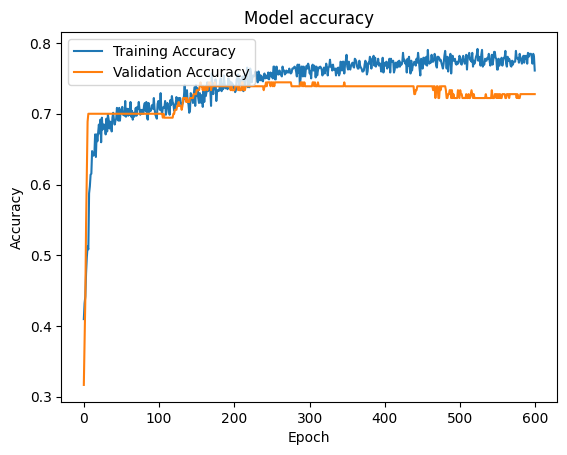

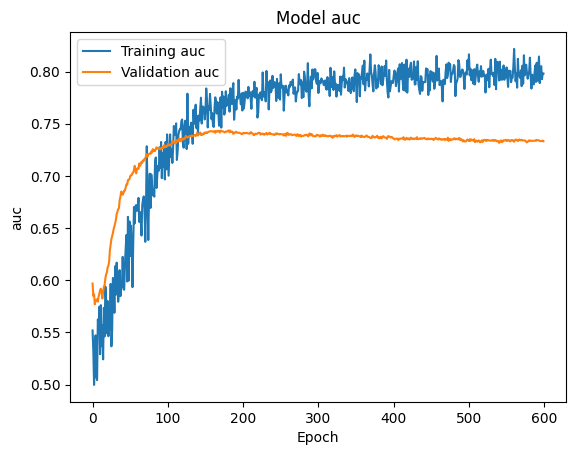

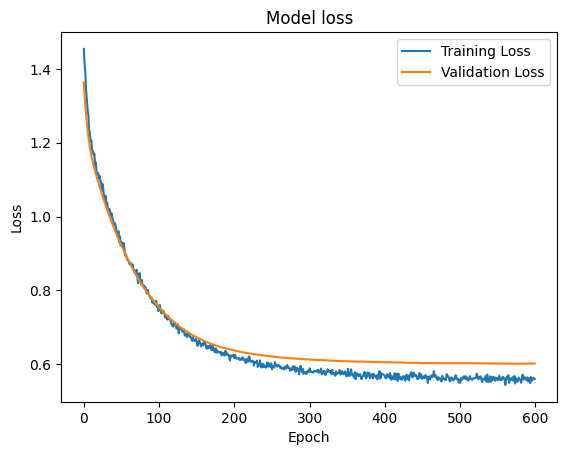

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 20s 942ms/step - accuracy: 0.6875 - auc: 0.7220 - balanced_accuracy: 0.5064 - f1_score: 0.8395 - loss: 0.8732 - precision: 0.7486
Epoch 1: val_loss improved from inf to 0.86356, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.7078 - auc: 0.6714 - balanced_accuracy: 0.5034 - f1_score: 0.8395 - loss: 0.8605 - precision: 0.7319 - val_accuracy: 0.6833 - val_auc: 0.6392 - val_balanced_accuracy: 0.4994 - val_f1_score: 0.8395 - val_loss: 0.8636 - val_precision: 0.6971
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.6875 - auc: 0.7227 - balanced_accuracy: 0.5000 - f1_score: 0.8395 - loss: 0.8482 - precision: 0.6875
Epoch 2: val_loss improved from 0.86356 to 0.85804, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7084 - auc: 0.6517 - balanced_accuracy: 0.4992 - f1_score: 0.8395 - loss: 0.8489 - precision: 0.7121 - val_accuracy: 0.6778 - val

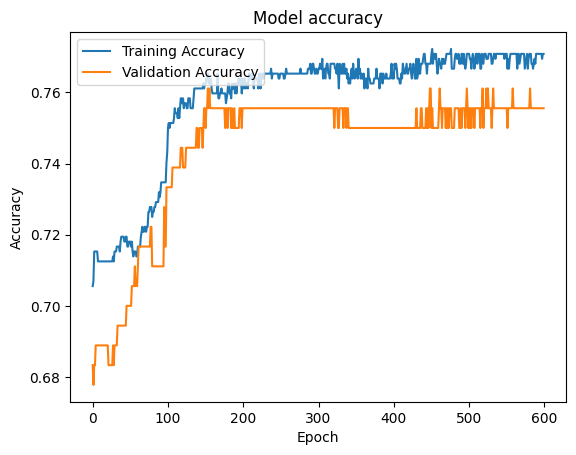

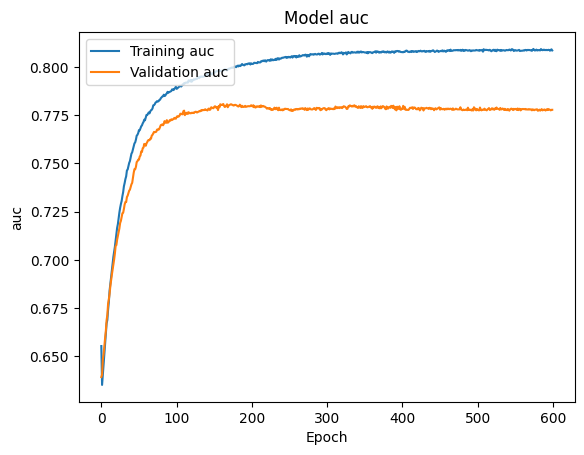

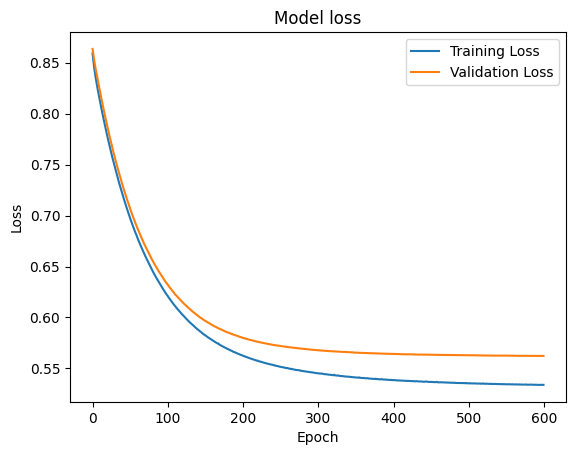

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 33s 2s/step - accuracy: 0.5938 - auc: 0.7623 - balanced_accuracy: 0.5216 - f1_score: 0.8399 - loss: 0.9094 - precision: 0.7716
Epoch 1: val_loss improved from inf to 0.93480, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.5127 - auc: 0.5841 - balanced_accuracy: 0.5029 - f1_score: 0.8399 - loss: 0.9910 - precision: 0.7365 - val_accuracy: 0.5944 - val_auc: 0.4443 - val_balanced_accuracy: 0.5012 - val_f1_score: 0.8399 - val_loss: 0.9348 - val_precision: 0.7023
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.5938 - auc: 0.5234 - balanced_accuracy: 0.5000 - f1_score: 0.8399 - loss: 0.9790 - precision: 0.5714
Epoch 2: val_loss improved from 0.93480 to 0.91498, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5596 - auc: 0.4671 - balanced_accuracy: 0.4985 - f1_score: 0.8399 - loss: 0.9687 - precision: 0.6841 - val_accuracy: 0.6444 - val_au

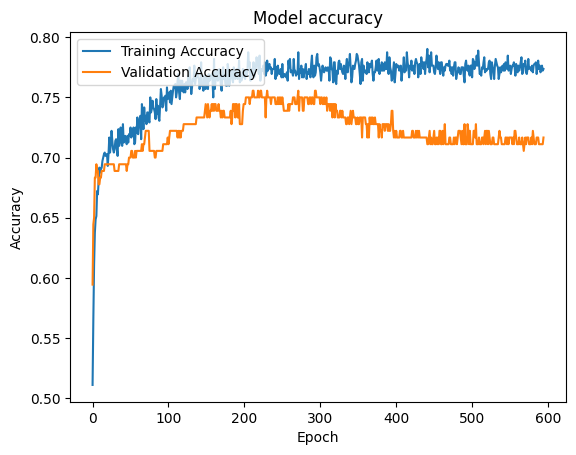

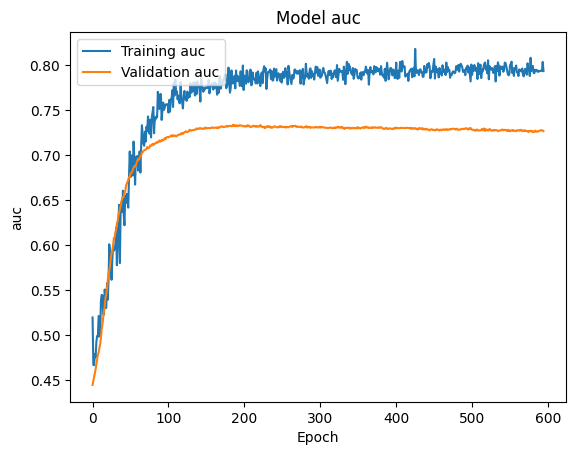

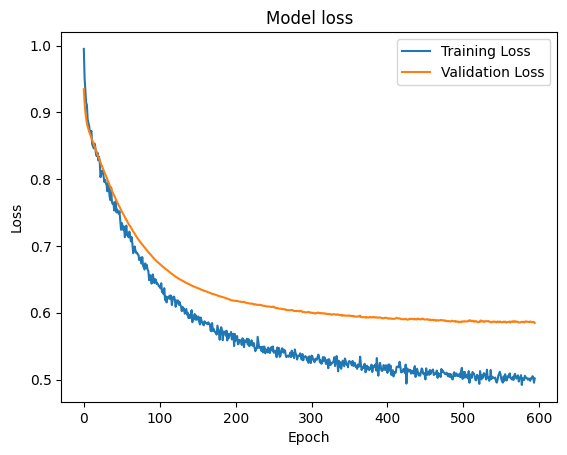

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
Averaging Probabilities Accuracy: 0.78
Averaging Probabilities AUC: 0.8333333333333334
Averaging Probabilities F1 Score: 0.8493150684931505


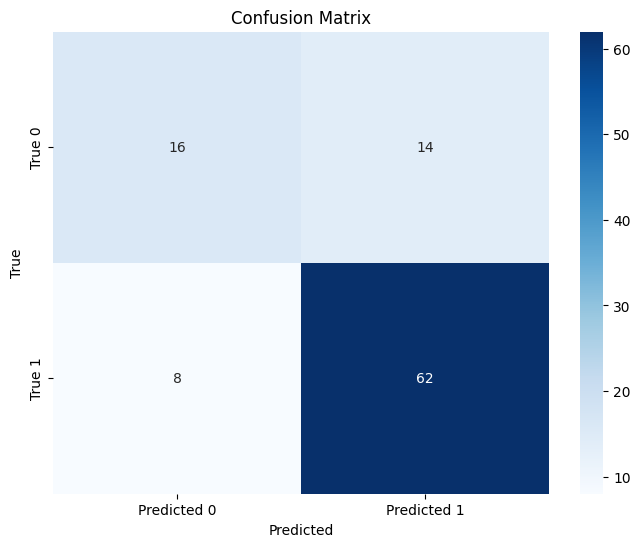

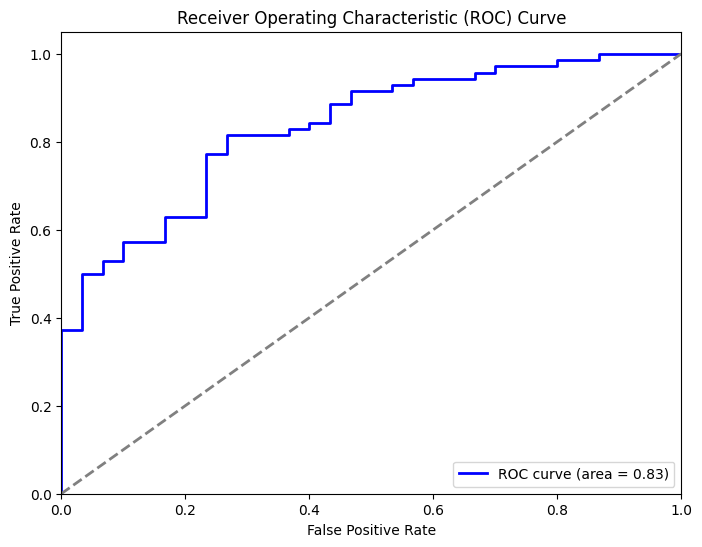

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 21s 973ms/step - accuracy: 0.5625 - auc: 0.6856 - balanced_accuracy: 0.4900 - f1_score: 0.8400 - loss: 1.0538 - precision: 0.7959
Epoch 1: val_loss improved from inf to 1.01170, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4739 - auc: 0.5942 - balanced_accuracy: 0.4988 - f1_score: 0.8400 - loss: 1.0462 - precision: 0.7557 - val_accuracy: 0.4722 - val_auc: 0.5369 - val_balanced_accuracy: 0.5001 - val_f1_score: 0.8400 - val_loss: 1.0117 - val_precision: 0.7541
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.4375 - auc: 0.4614 - balanced_accuracy: 0.5000 - f1_score: 0.8400 - loss: 1.0424 - precision: 0.6250
Epoch 2: val_loss improved from 1.01170 to 0.98754, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5223 - auc: 0.5486 - balanced_accuracy: 0.5013 - f1_score: 0.8400 - loss: 1.0094 - precision: 0.7327 - val_accuracy: 0.5833 - val

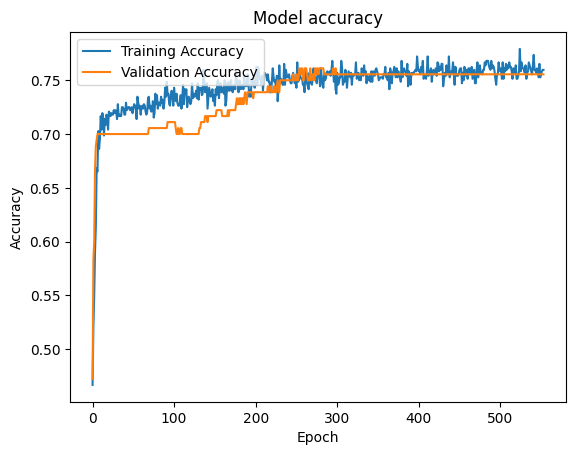

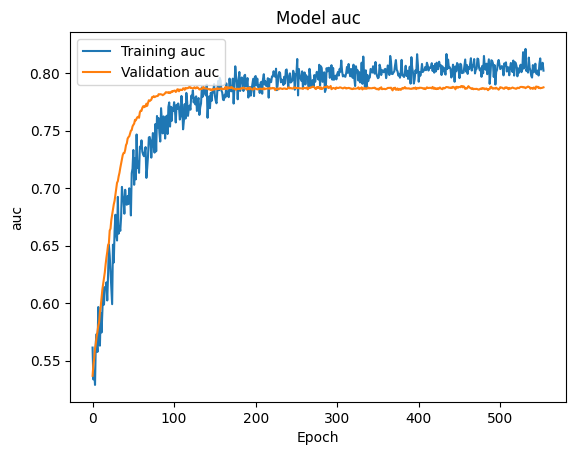

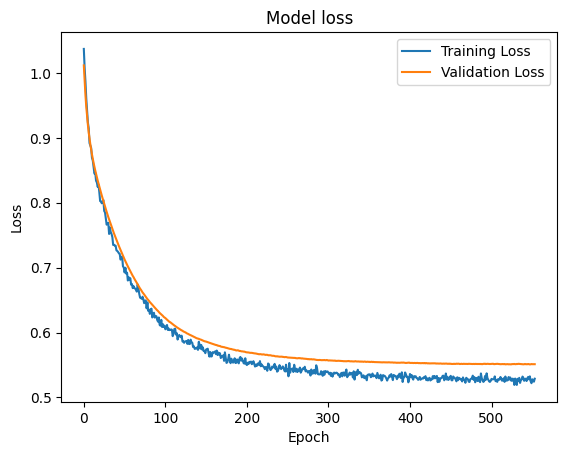

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 26s 1s/step - accuracy: 0.7500 - auc: 0.7446 - balanced_accuracy: 0.5007 - f1_score: 0.8401 - loss: 1.2583 - precision: 0.7809
Epoch 1: val_loss improved from inf to 1.24566, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.6619 - auc: 0.6747 - balanced_accuracy: 0.5044 - f1_score: 0.8401 - loss: 1.2643 - precision: 0.7719 - val_accuracy: 0.7000 - val_auc: 0.6975 - val_balanced_accuracy: 0.5028 - val_f1_score: 0.8401 - val_loss: 1.2457 - val_precision: 0.7222
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.5625 - auc: 0.5526 - balanced_accuracy: 0.5000 - f1_score: 0.8401 - loss: 1.3254 - precision: 0.6316
Epoch 2: val_loss improved from 1.24566 to 1.22737, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6006 - auc: 0.5311 - balanced_accuracy: 0.5040 - f1_score: 0.8401 - loss: 1.2865 - precision: 0.7131 - val_accuracy: 0.7111 - val_au

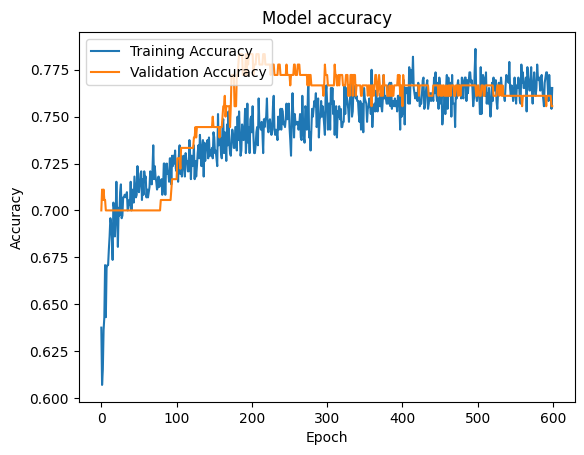

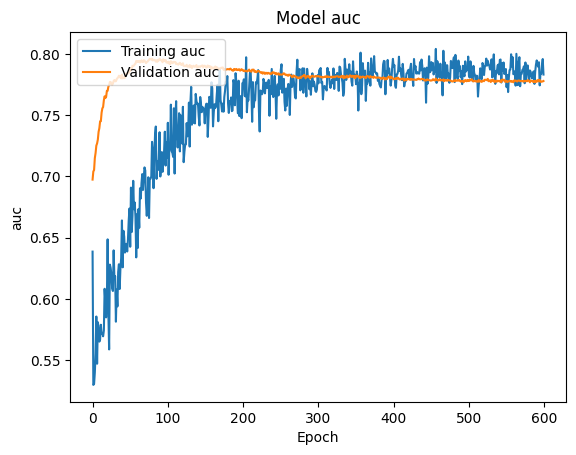

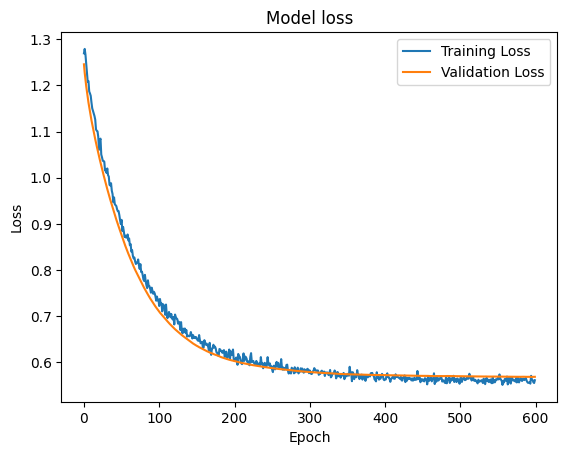

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 21s 967ms/step - accuracy: 0.6875 - auc: 0.7496 - balanced_accuracy: 0.5025 - f1_score: 0.8402 - loss: 0.9170 - precision: 0.7541
Epoch 1: val_loss improved from inf to 0.86210, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.6865 - auc: 0.6687 - balanced_accuracy: 0.5010 - f1_score: 0.8402 - loss: 0.8840 - precision: 0.7130 - val_accuracy: 0.6889 - val_auc: 0.5884 - val_balanced_accuracy: 0.4992 - val_f1_score: 0.8402 - val_loss: 0.8621 - val_precision: 0.6966
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.8750 - auc: 0.4955 - balanced_accuracy: 0.5000 - f1_score: 0.8402 - loss: 0.7473 - precision: 0.8750
Epoch 2: val_loss improved from 0.86210 to 0.85572, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.7292 - auc: 0.6249 - balanced_accuracy: 0.5013 - f1_score: 0.8402 - loss: 0.8388 - precision: 0.7269 - val_accuracy: 0.6889 - val

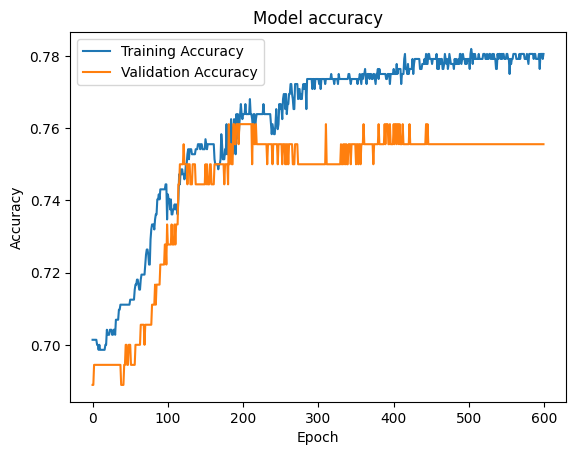

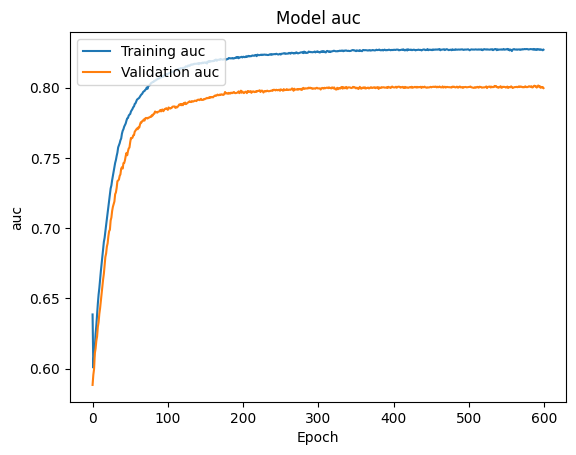

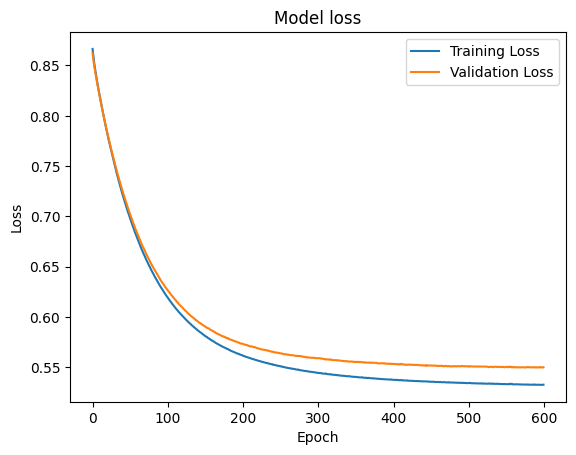

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 36s 2s/step - accuracy: 0.5000 - auc: 0.7537 - balanced_accuracy: 0.5120 - f1_score: 0.8404 - loss: 1.0758 - precision: 0.7636
Epoch 1: val_loss improved from inf to 0.96517, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.4543 - auc: 0.5811 - balanced_accuracy: 0.5006 - f1_score: 0.8404 - loss: 1.0638 - precision: 0.7152 - val_accuracy: 0.4889 - val_auc: 0.4261 - val_balanced_accuracy: 0.4927 - val_f1_score: 0.8404 - val_loss: 0.9652 - val_precision: 0.6545
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.5625 - auc: 0.4864 - balanced_accuracy: 0.5000 - f1_score: 0.8404 - loss: 0.9848 - precision: 0.7000
Epoch 2: val_loss improved from 0.96517 to 0.93506, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4957 - auc: 0.4555 - balanced_accuracy: 0.4999 - f1_score: 0.8404 - loss: 1.0267 - precision: 0.6535 - val_accuracy: 0.5833 - val_au

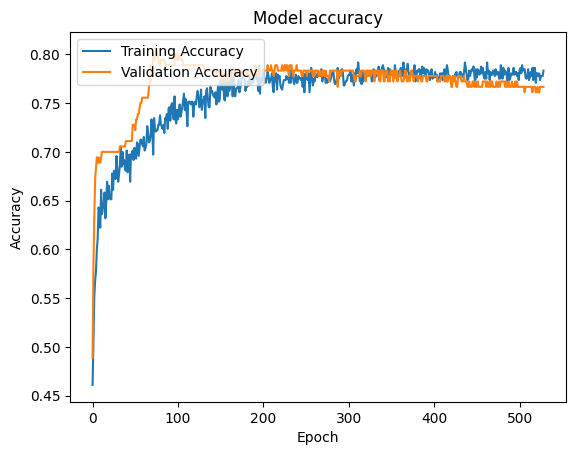

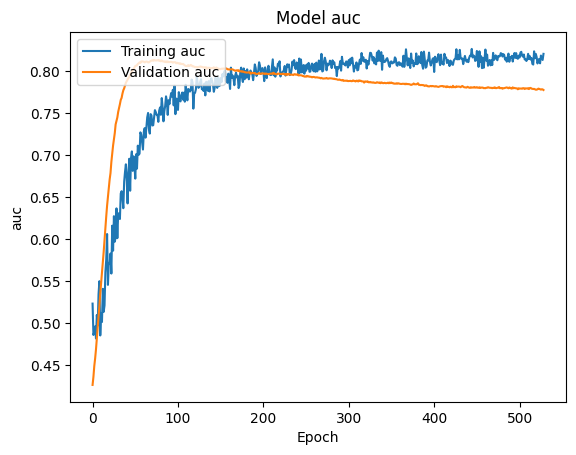

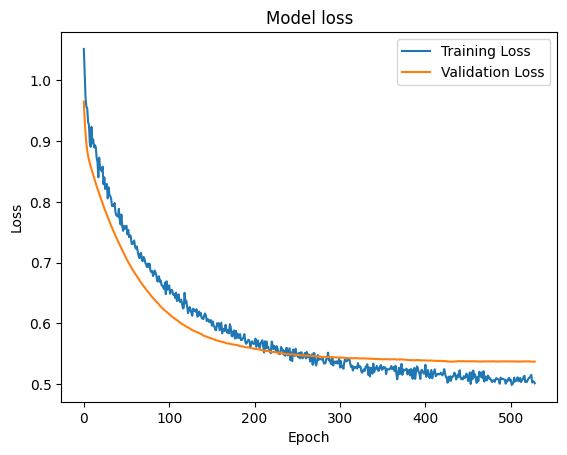

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
Averaging Probabilities Accuracy: 0.79
Averaging Probabilities AUC: 0.8019047619047619
Averaging Probabilities F1 Score: 0.8627450980392157


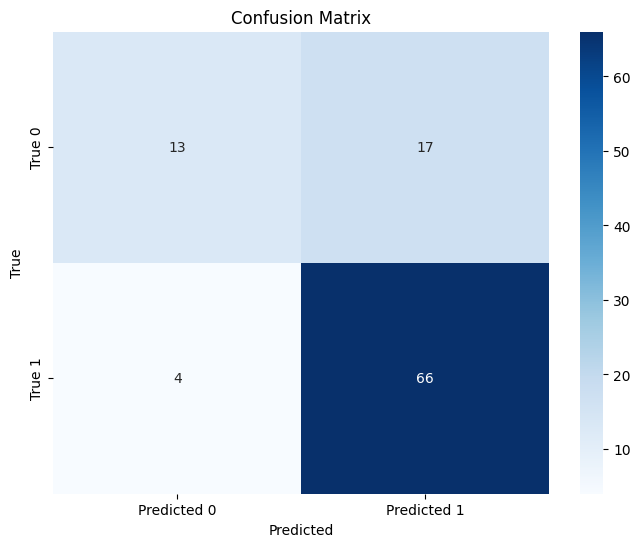

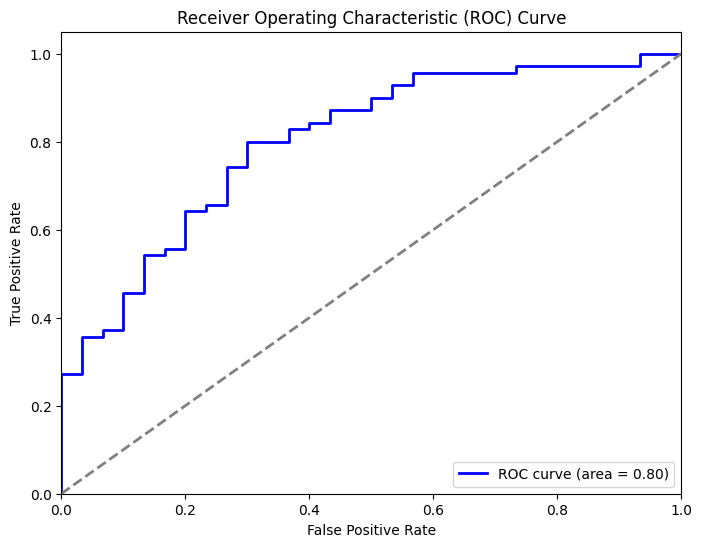

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 23s 1s/step - accuracy: 0.4062 - auc: 0.7445 - balanced_accuracy: 0.5176 - f1_score: 0.8403 - loss: 1.1014 - precision: 0.7829
Epoch 1: val_loss improved from inf to 1.07288, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.3793 - auc: 0.5954 - balanced_accuracy: 0.5058 - f1_score: 0.8403 - loss: 1.1101 - precision: 0.7469 - val_accuracy: 0.3389 - val_auc: 0.4701 - val_balanced_accuracy: 0.5058 - val_f1_score: 0.8403 - val_loss: 1.0729 - val_precision: 0.5946
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step - accuracy: 0.4062 - auc: 0.3227 - balanced_accuracy: 0.5000 - f1_score: 0.8403 - loss: 1.0950 - precision: 0.6154
Epoch 2: val_loss improved from 1.07288 to 1.04368, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4128 - auc: 0.4195 - balanced_accuracy: 0.4978 - f1_score: 0.8403 - loss: 1.0938 - precision: 0.6716 - val_accuracy: 0.4333 - val_au

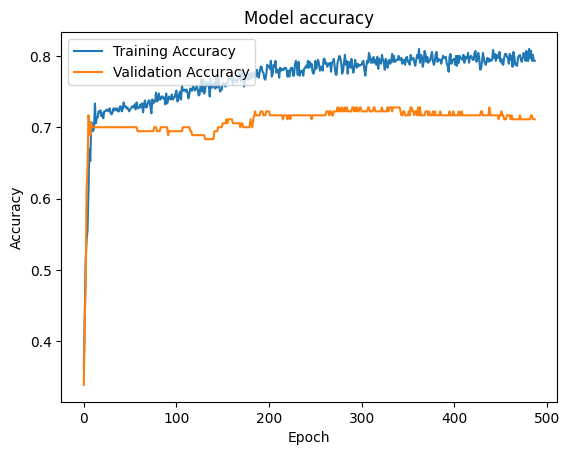

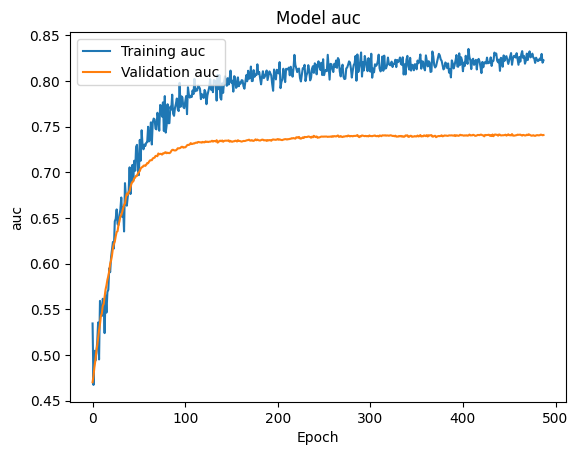

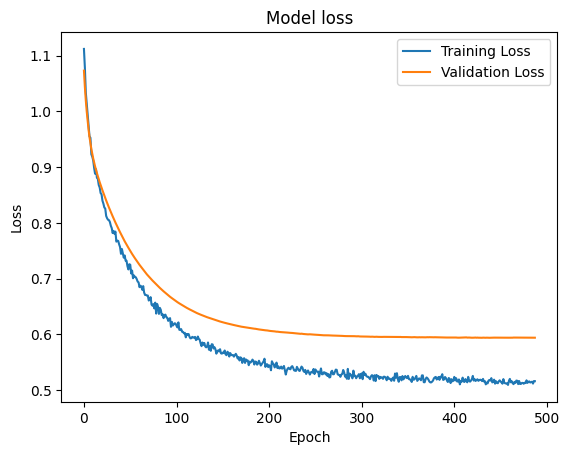

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 27s 1s/step - accuracy: 0.5312 - auc: 0.6960 - balanced_accuracy: 0.4974 - f1_score: 0.8407 - loss: 1.3637 - precision: 0.7546
Epoch 1: val_loss improved from inf to 1.33810, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.5073 - auc: 0.6162 - balanced_accuracy: 0.5031 - f1_score: 0.8407 - loss: 1.3541 - precision: 0.7424 - val_accuracy: 0.4278 - val_auc: 0.5185 - val_balanced_accuracy: 0.5055 - val_f1_score: 0.8407 - val_loss: 1.3381 - val_precision: 0.6885
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.4688 - auc: 0.5266 - balanced_accuracy: 0.5000 - f1_score: 0.8407 - loss: 1.4046 - precision: 0.7500
Epoch 2: val_loss improved from 1.33810 to 1.31412, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5139 - auc: 0.5449 - balanced_accuracy: 0.5003 - f1_score: 0.8407 - loss: 1.3511 - precision: 0.7270 - val_accuracy: 0.5111 - val_au

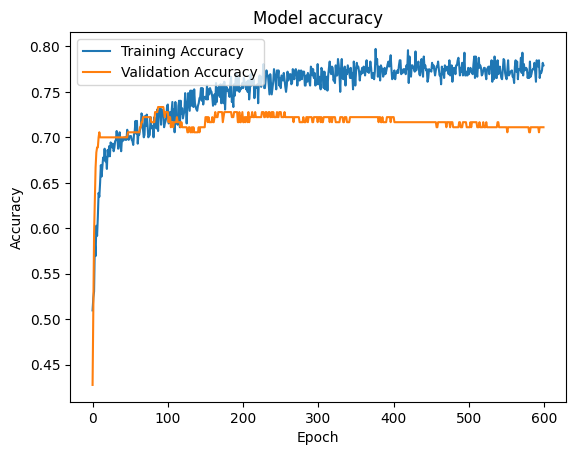

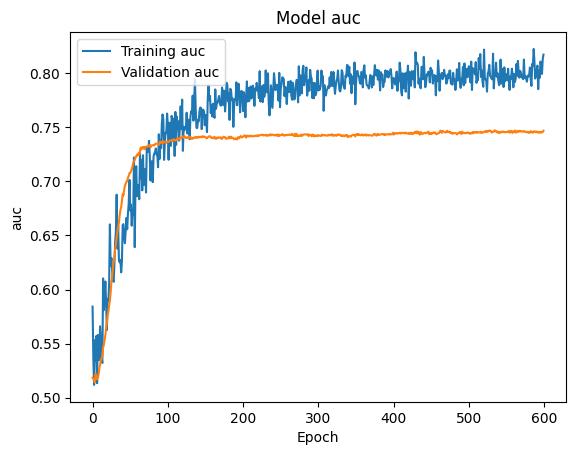

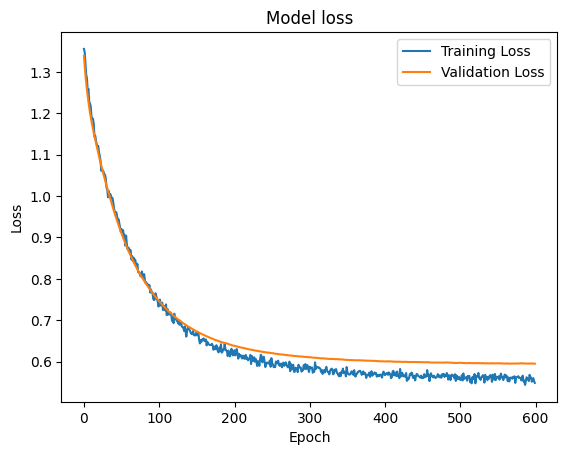

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 21s 1000ms/step - accuracy: 0.2812 - auc: 0.6959 - balanced_accuracy: 0.4973 - f1_score: 0.8405 - loss: 1.0343 - precision: 0.7434
Epoch 1: val_loss improved from inf to 0.98110, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.3815 - auc: 0.6136 - balanced_accuracy: 0.5001 - f1_score: 0.8405 - loss: 1.0225 - precision: 0.7449 - val_accuracy: 0.5222 - val_auc: 0.6174 - val_balanced_accuracy: 0.5001 - val_f1_score: 0.8405 - val_loss: 0.9811 - val_precision: 0.8030
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.4062 - auc: 0.5703 - balanced_accuracy: 0.5000 - f1_score: 0.8405 - loss: 1.0215 - precision: 0.7778
Epoch 2: val_loss improved from 0.98110 to 0.95149, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4747 - auc: 0.6078 - balanced_accuracy: 0.5039 - f1_score: 0.8404 - loss: 0.9871 - precision: 0.7529 - val_accuracy: 0.5556 - va

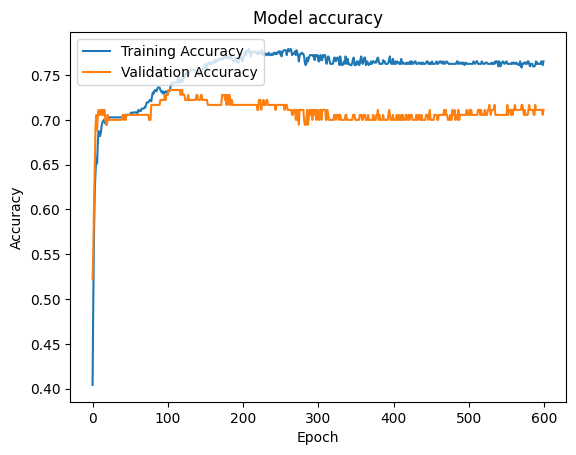

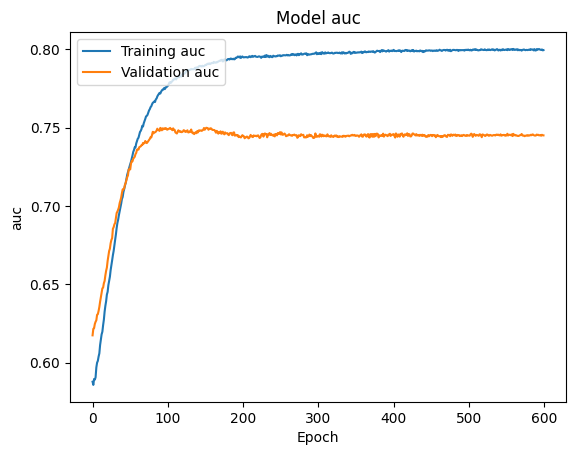

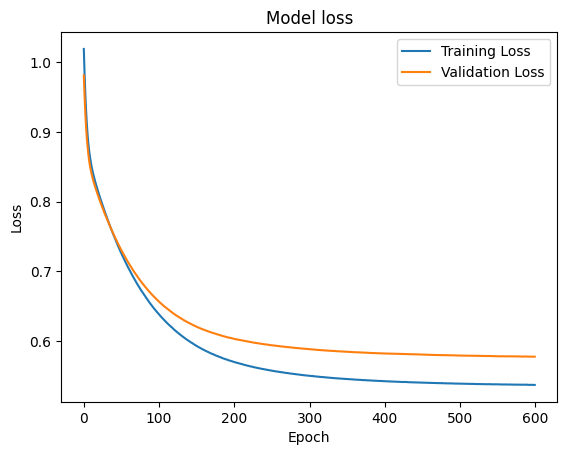

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 34s 2s/step - accuracy: 0.3750 - auc: 0.6834 - balanced_accuracy: 0.4871 - f1_score: 0.8404 - loss: 1.1120 - precision: 0.7407
Epoch 1: val_loss improved from inf to 1.00969, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.4199 - auc: 0.5655 - balanced_accuracy: 0.4944 - f1_score: 0.8404 - loss: 1.0738 - precision: 0.7222 - val_accuracy: 0.4167 - val_auc: 0.4527 - val_balanced_accuracy: 0.5042 - val_f1_score: 0.8404 - val_loss: 1.0097 - val_precision: 0.6567
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.4375 - auc: 0.4114 - balanced_accuracy: 0.5000 - f1_score: 0.8404 - loss: 0.9917 - precision: 0.7333
Epoch 2: val_loss improved from 1.00969 to 0.96573, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4661 - auc: 0.4985 - balanced_accuracy: 0.4974 - f1_score: 0.8404 - loss: 1.0035 - precision: 0.6856 - val_accuracy: 0.5222 - val_au

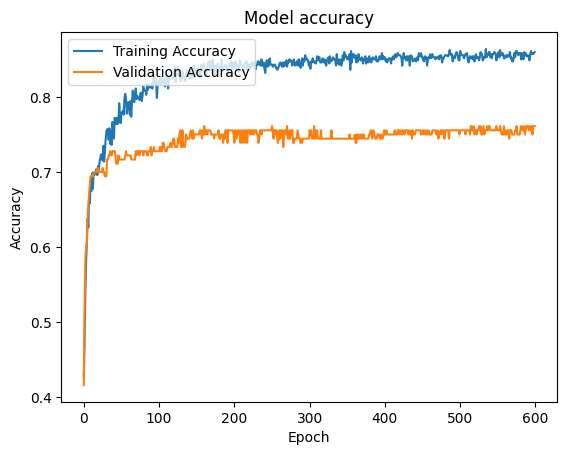

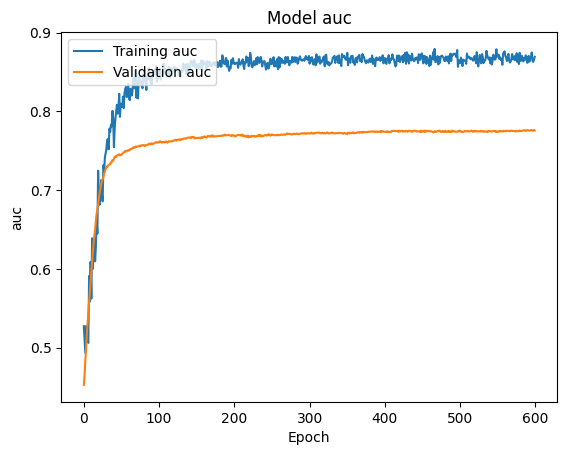

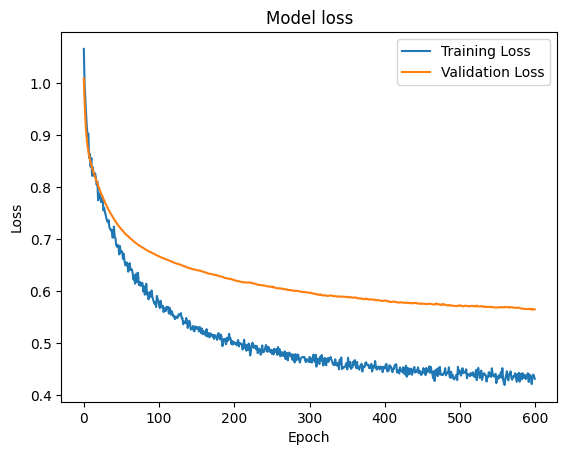

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
Averaging Probabilities Accuracy: 0.73
Averaging Probabilities AUC: 0.8152380952380952
Averaging Probabilities F1 Score: 0.8280254777070064


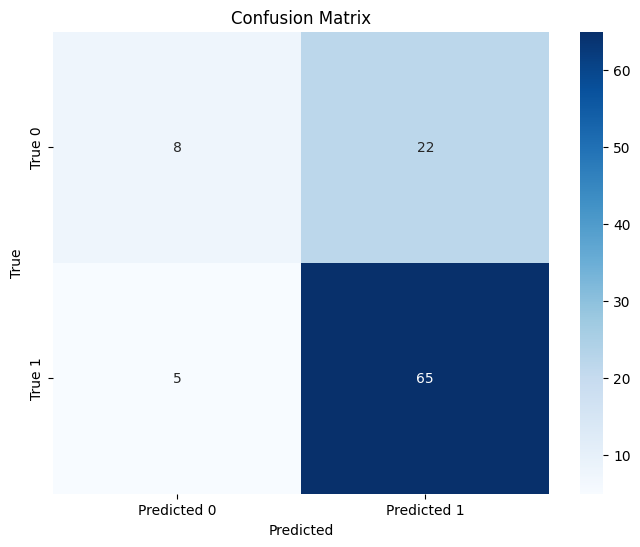

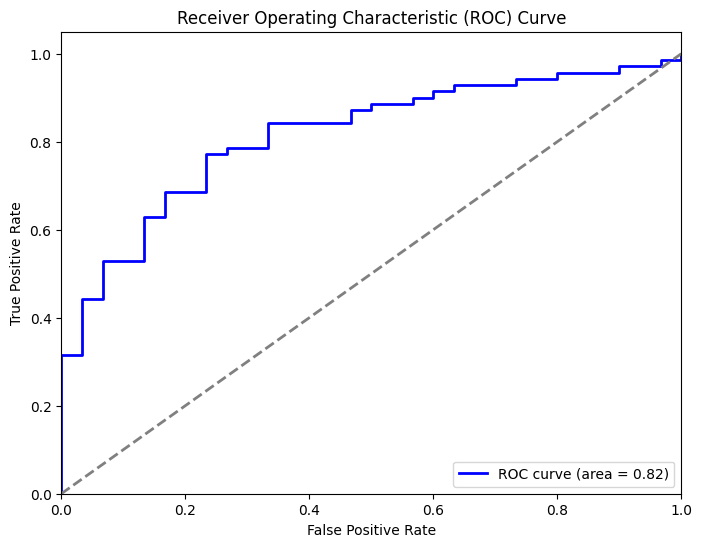

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 22s 1s/step - accuracy: 0.4688 - auc: 0.7370 - balanced_accuracy: 0.4903 - f1_score: 0.8417 - loss: 1.0553 - precision: 0.8108
Epoch 1: val_loss improved from inf to 0.97441, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.5351 - auc: 0.6190 - balanced_accuracy: 0.4960 - f1_score: 0.8417 - loss: 1.0249 - precision: 0.7445 - val_accuracy: 0.6389 - val_auc: 0.5564 - val_balanced_accuracy: 0.5004 - val_f1_score: 0.8417 - val_loss: 0.9744 - val_precision: 0.7103
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.5938 - auc: 0.4394 - balanced_accuracy: 0.5000 - f1_score: 0.8417 - loss: 1.0188 - precision: 0.6818
Epoch 2: val_loss improved from 0.97441 to 0.95429, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5417 - auc: 0.4659 - balanced_accuracy: 0.4973 - f1_score: 0.8417 - loss: 1.0145 - precision: 0.6669 - val_accuracy: 0.6889 - val_au

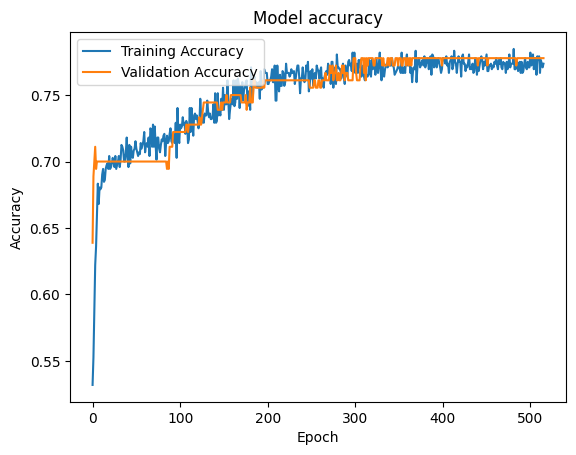

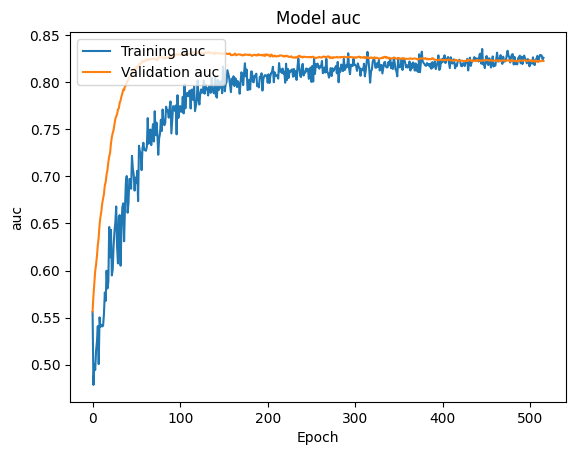

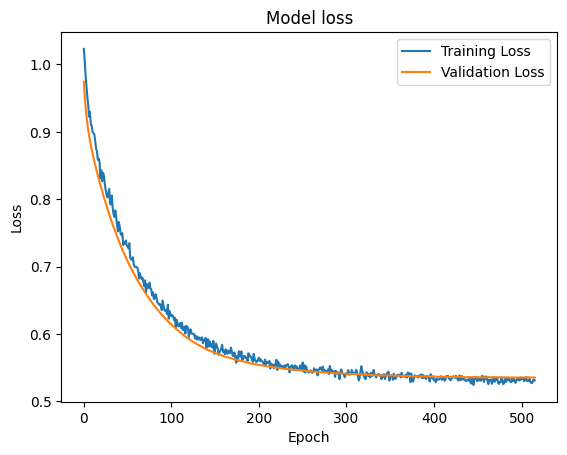

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 26s 1s/step - accuracy: 0.5625 - auc: 0.7897 - balanced_accuracy: 0.5038 - f1_score: 0.8418 - loss: 1.2811 - precision: 0.7784
Epoch 1: val_loss improved from inf to 1.30031, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.4913 - auc: 0.6237 - balanced_accuracy: 0.5060 - f1_score: 0.8418 - loss: 1.3192 - precision: 0.7118 - val_accuracy: 0.4889 - val_auc: 0.4149 - val_balanced_accuracy: 0.5040 - val_f1_score: 0.8418 - val_loss: 1.3003 - val_precision: 0.6574
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.3125 - auc: 0.2947 - balanced_accuracy: 0.5000 - f1_score: 0.8418 - loss: 1.3624 - precision: 0.5333
Epoch 2: val_loss improved from 1.30031 to 1.27945, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4644 - auc: 0.4389 - balanced_accuracy: 0.4959 - f1_score: 0.8418 - loss: 1.3156 - precision: 0.6198 - val_accuracy: 0.6000 - val_au

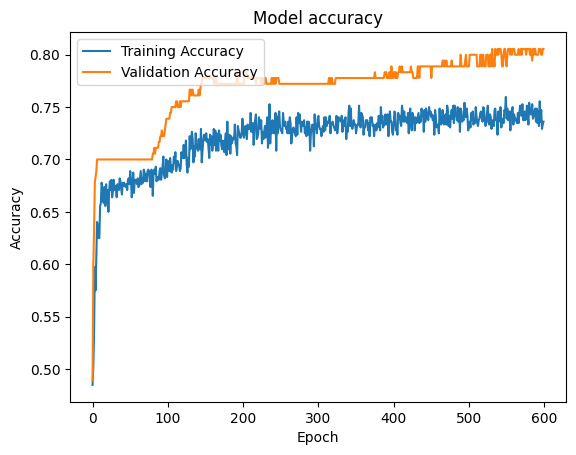

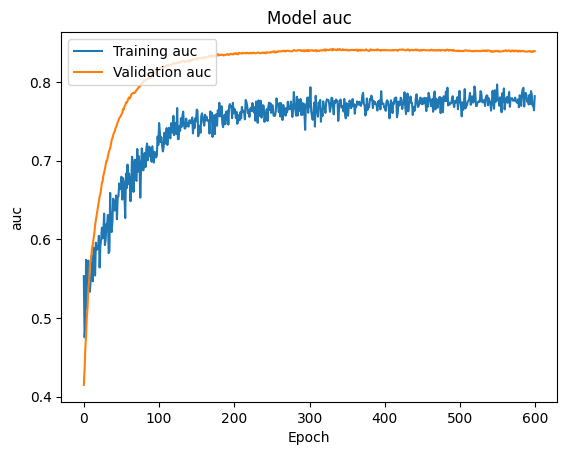

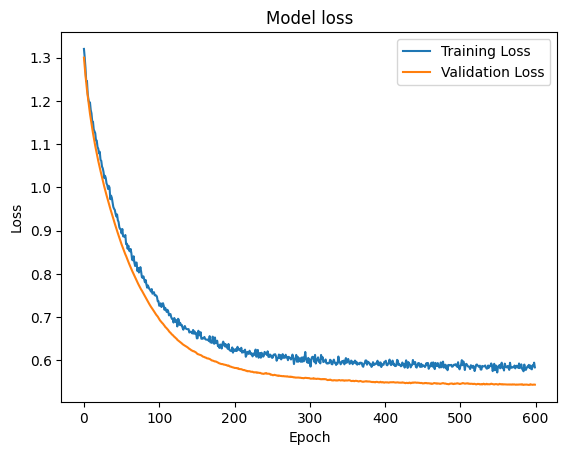

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 21s 960ms/step - accuracy: 0.3438 - auc: 0.7427 - balanced_accuracy: 0.4820 - f1_score: 0.8411 - loss: 1.1242 - precision: 0.7963
Epoch 1: val_loss improved from inf to 1.06050, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.3531 - auc: 0.5675 - balanced_accuracy: 0.4858 - f1_score: 0.8411 - loss: 1.0950 - precision: 0.7603 - val_accuracy: 0.4000 - val_auc: 0.4436 - val_balanced_accuracy: 0.5003 - val_f1_score: 0.8411 - val_loss: 1.0605 - val_precision: 0.6667
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.3750 - auc: 0.3968 - balanced_accuracy: 0.5000 - f1_score: 0.8411 - loss: 1.0685 - precision: 0.4545
Epoch 2: val_loss improved from 1.06050 to 1.02714, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3863 - auc: 0.4713 - balanced_accuracy: 0.5020 - f1_score: 0.8411 - loss: 1.0502 - precision: 0.6341 - val_accuracy: 0.4278 - val

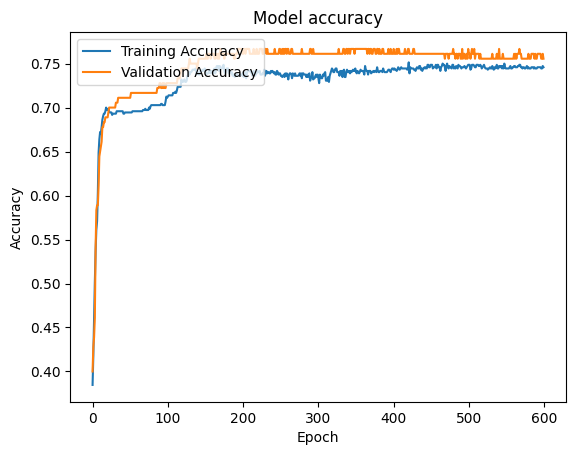

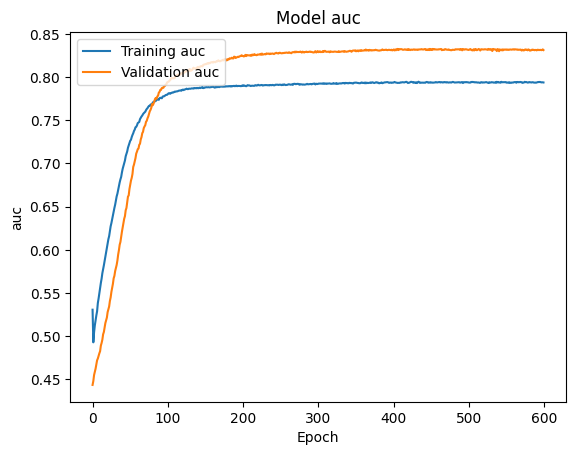

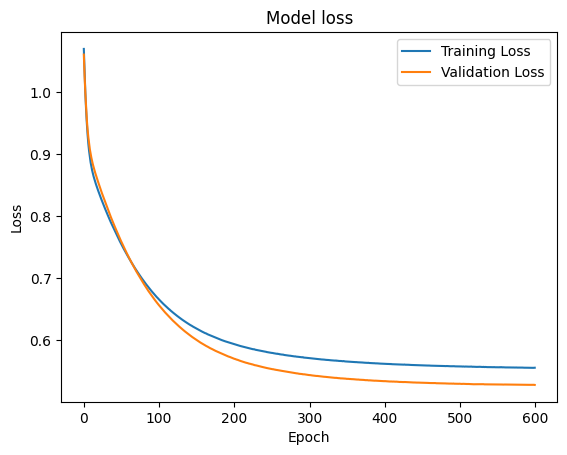

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 24s 1s/step - accuracy: 0.4375 - auc: 0.7758 - balanced_accuracy: 0.5176 - f1_score: 0.8407 - loss: 1.0737 - precision: 0.7561
Epoch 1: val_loss improved from inf to 1.03820, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.3886 - auc: 0.5940 - balanced_accuracy: 0.5064 - f1_score: 0.8407 - loss: 1.1263 - precision: 0.7313 - val_accuracy: 0.3278 - val_auc: 0.5480 - val_balanced_accuracy: 0.5020 - val_f1_score: 0.8407 - val_loss: 1.0382 - val_precision: 0.7778
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.3125 - auc: 0.3854 - balanced_accuracy: 0.5000 - f1_score: 0.8407 - loss: 1.1823 - precision: 0.6000
Epoch 2: val_loss improved from 1.03820 to 0.99829, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3996 - auc: 0.4454 - balanced_accuracy: 0.4955 - f1_score: 0.8407 - loss: 1.0906 - precision: 0.6165 - val_accuracy: 0.3500 - val_au

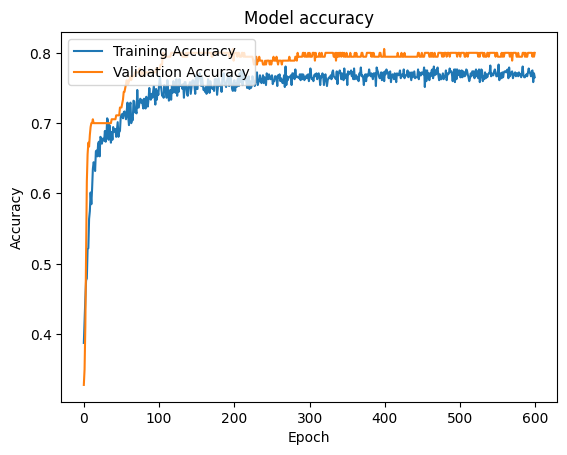

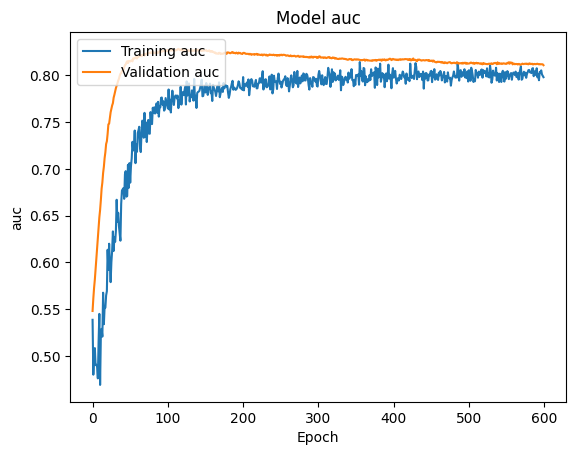

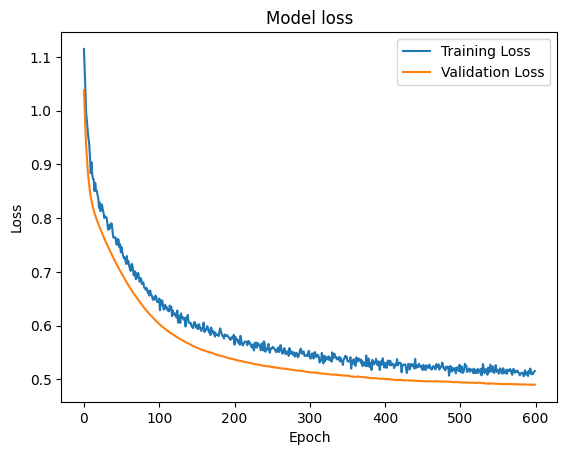

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 197ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
Averaging Probabilities Accuracy: 0.74
Averaging Probabilities AUC: 0.7933333333333333
Averaging Probabilities F1 Score: 0.8354430379746834


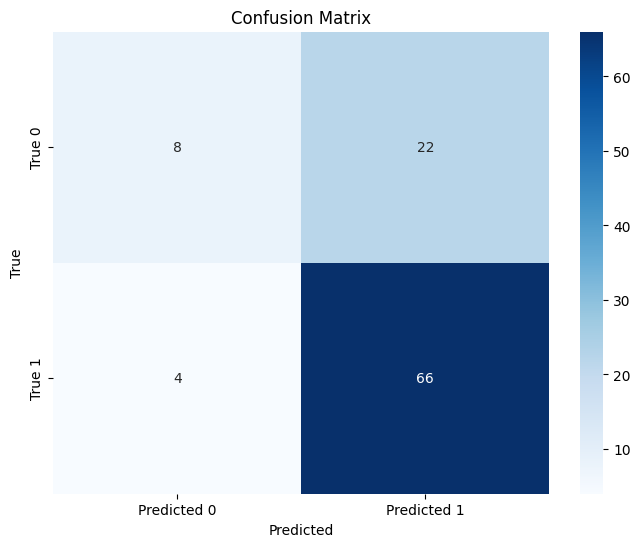

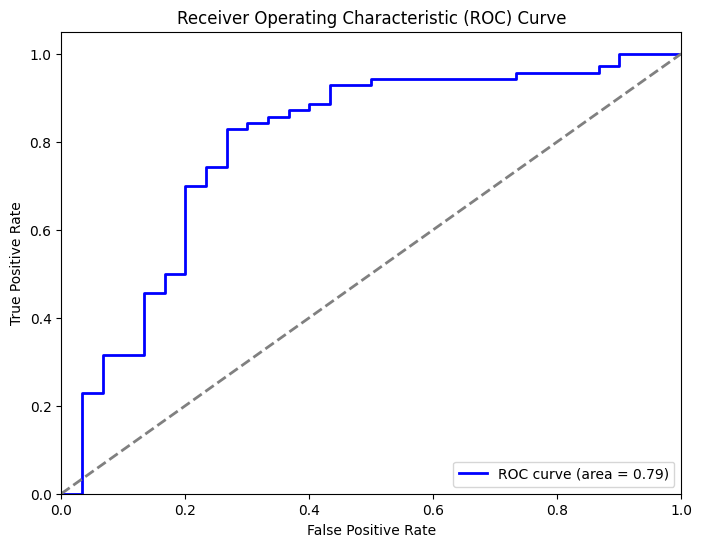

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 22s 1s/step - accuracy: 0.3438 - auc: 0.7644 - balanced_accuracy: 0.4946 - f1_score: 0.8406 - loss: 1.0681 - precision: 0.7962
Epoch 1: val_loss improved from inf to 1.01473, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.4651 - auc: 0.6330 - balanced_accuracy: 0.4973 - f1_score: 0.8406 - loss: 1.0417 - precision: 0.7559 - val_accuracy: 0.4500 - val_auc: 0.5239 - val_balanced_accuracy: 0.5017 - val_f1_score: 0.8406 - val_loss: 1.0147 - val_precision: 0.6667
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.4375 - auc: 0.3600 - balanced_accuracy: 0.5000 - f1_score: 0.8406 - loss: 1.0649 - precision: 0.7333
Epoch 2: val_loss improved from 1.01473 to 0.99429, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5258 - auc: 0.5145 - balanced_accuracy: 0.5005 - f1_score: 0.8406 - loss: 1.0203 - precision: 0.7349 - val_accuracy: 0.5500 - val_au

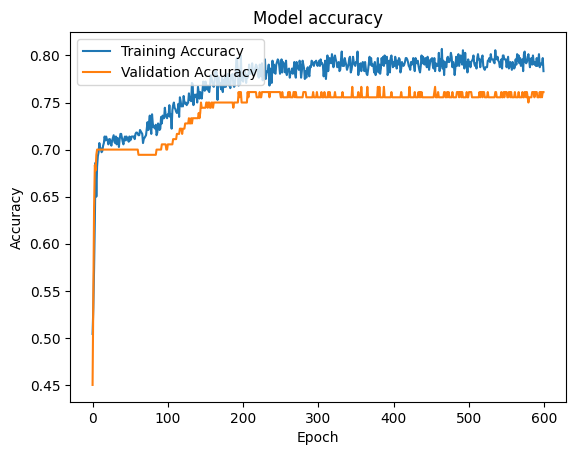

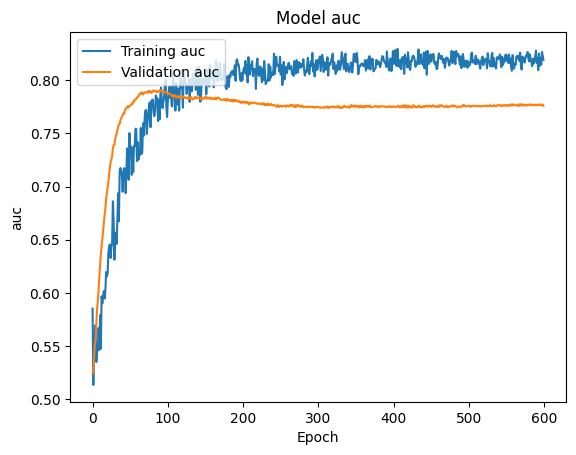

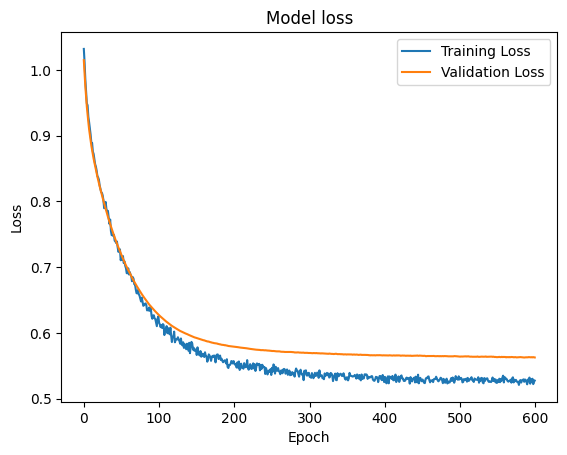

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 25s 1s/step - accuracy: 0.7500 - auc: 0.7356 - balanced_accuracy: 0.4993 - f1_score: 0.8410 - loss: 1.2990 - precision: 0.7579
Epoch 1: val_loss improved from inf to 1.25528, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.6947 - auc: 0.5993 - balanced_accuracy: 0.5008 - f1_score: 0.8410 - loss: 1.2766 - precision: 0.7436 - val_accuracy: 0.7000 - val_auc: 0.5161 - val_balanced_accuracy: 0.5000 - val_f1_score: 0.8410 - val_loss: 1.2553 - val_precision: 0.7000
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.6562 - auc: 0.5290 - balanced_accuracy: 0.5000 - f1_score: 0.8410 - loss: 1.2478 - precision: 0.7000
Epoch 2: val_loss improved from 1.25528 to 1.24216, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6467 - auc: 0.4745 - balanced_accuracy: 0.5016 - f1_score: 0.8410 - loss: 1.2750 - precision: 0.6939 - val_accuracy: 0.7000 - val_au

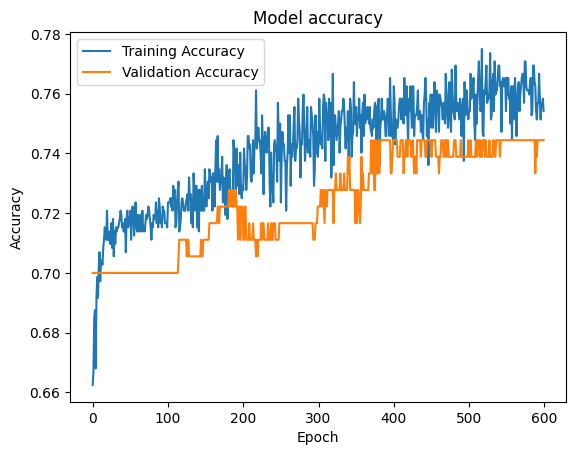

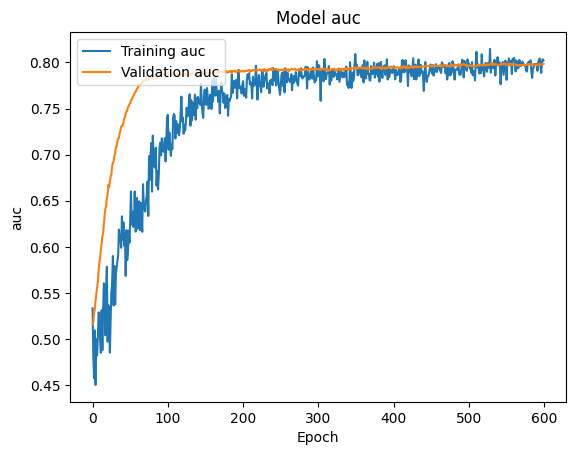

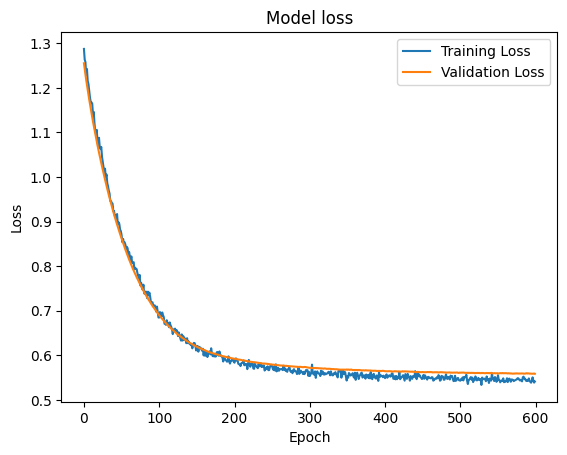

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 21s 982ms/step - accuracy: 0.8125 - auc: 0.7477 - balanced_accuracy: 0.4956 - f1_score: 0.8409 - loss: 0.9006 - precision: 0.7705
Epoch 1: val_loss improved from inf to 0.92255, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.6703 - auc: 0.5556 - balanced_accuracy: 0.4961 - f1_score: 0.8409 - loss: 0.9285 - precision: 0.7222 - val_accuracy: 0.6556 - val_auc: 0.3920 - val_balanced_accuracy: 0.4995 - val_f1_score: 0.8409 - val_loss: 0.9225 - val_precision: 0.6882
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.6875 - auc: 0.2319 - balanced_accuracy: 0.5000 - f1_score: 0.8409 - loss: 0.9179 - precision: 0.7097
Epoch 2: val_loss improved from 0.92255 to 0.90829, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6672 - auc: 0.3921 - balanced_accuracy: 0.5009 - f1_score: 0.8409 - loss: 0.9178 - precision: 0.6871 - val_accuracy: 0.7000 - val

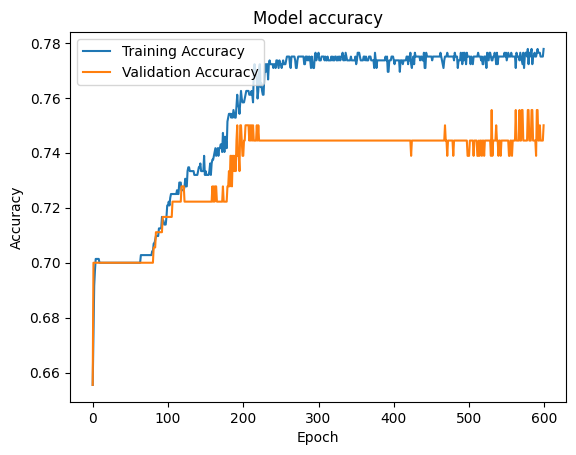

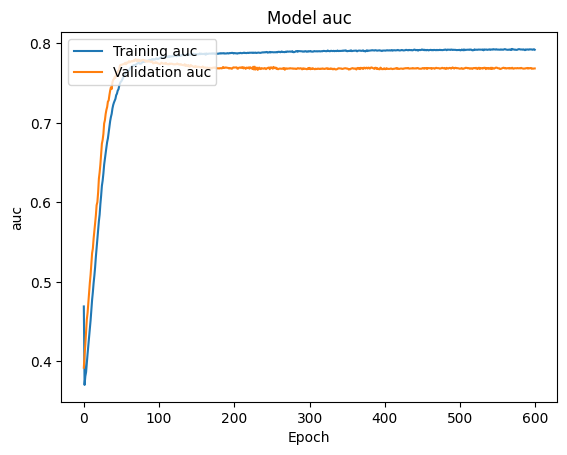

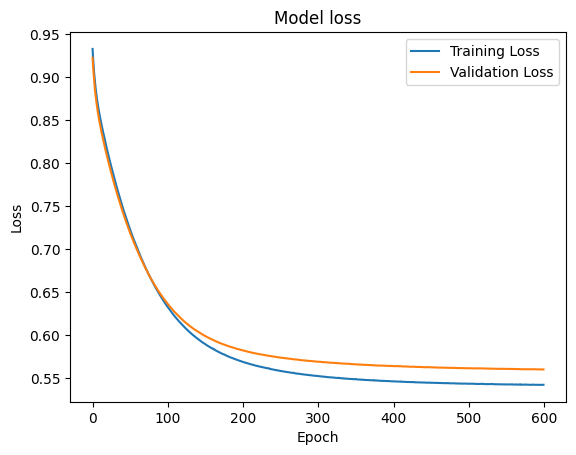

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 30s 1s/step - accuracy: 0.6562 - auc: 0.7474 - balanced_accuracy: 0.4980 - f1_score: 0.8410 - loss: 0.8793 - precision: 0.7644
Epoch 1: val_loss improved from inf to 0.87030, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.5980 - auc: 0.6354 - balanced_accuracy: 0.4987 - f1_score: 0.8410 - loss: 0.9193 - precision: 0.7498 - val_accuracy: 0.7333 - val_auc: 0.6984 - val_balanced_accuracy: 0.4999 - val_f1_score: 0.8410 - val_loss: 0.8703 - val_precision: 0.7786
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 6s 275ms/step - accuracy: 0.5938 - auc: 0.6083 - balanced_accuracy: 0.5000 - f1_score: 0.8410 - loss: 0.9069 - precision: 0.6522
Epoch 2: val_loss improved from 0.87030 to 0.85398, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6586 - auc: 0.6393 - balanced_accuracy: 0.5004 - f1_score: 0.8410 - loss: 0.8800 - precision: 0.7704 - val_accuracy: 0.7389 - val_a

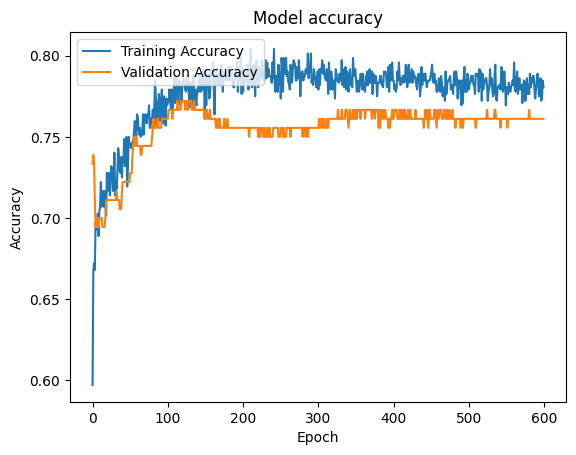

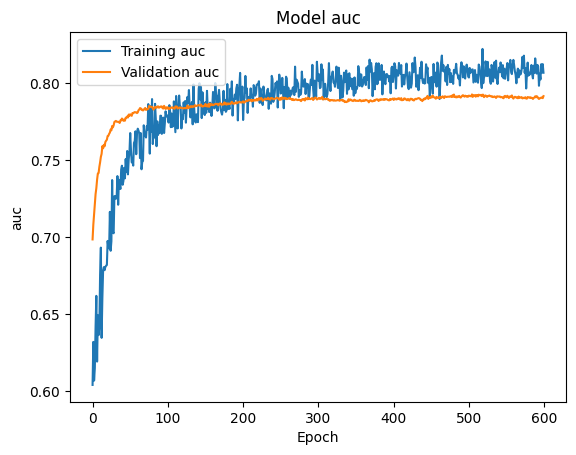

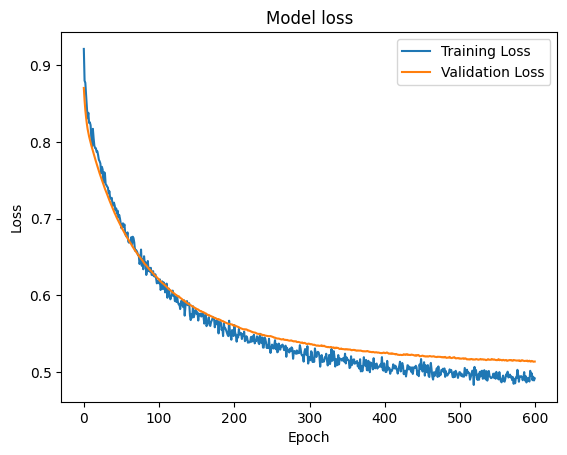

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
Averaging Probabilities Accuracy: 0.72
Averaging Probabilities AUC: 0.7647619047619048
Averaging Probabilities F1 Score: 0.8157894736842105


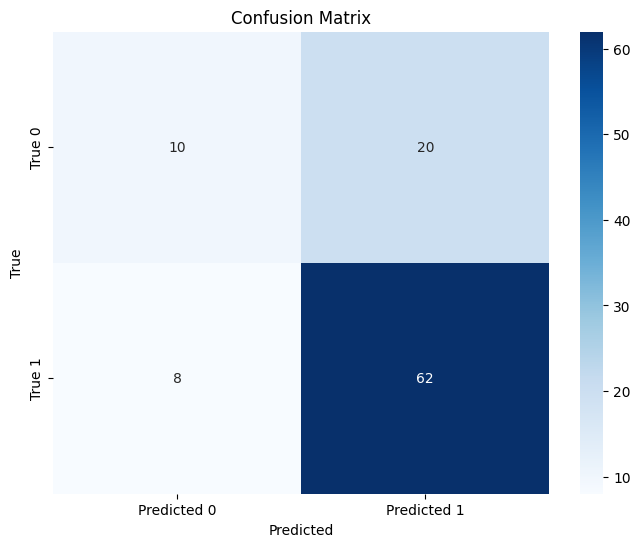

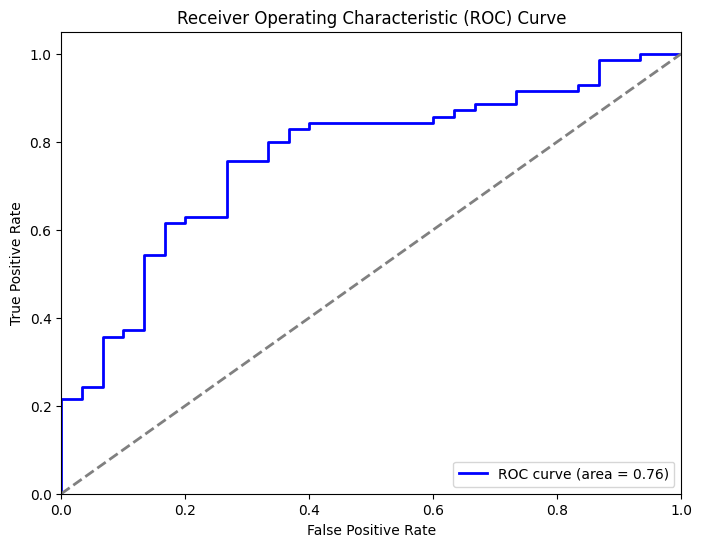

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 22s 1s/step - accuracy: 0.2812 - auc: 0.7301 - balanced_accuracy: 0.4748 - f1_score: 0.8413 - loss: 1.1771 - precision: 0.7891
Epoch 1: val_loss improved from inf to 1.08769, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.3435 - auc: 0.6028 - balanced_accuracy: 0.4930 - f1_score: 0.8413 - loss: 1.1265 - precision: 0.7747 - val_accuracy: 0.3278 - val_auc: 0.5983 - val_balanced_accuracy: 0.5010 - val_f1_score: 0.8413 - val_loss: 1.0877 - val_precision: 1.0000
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.4688 - auc: 0.5456 - balanced_accuracy: 0.5000 - f1_score: 0.8413 - loss: 1.0381 - precision: 0.5714
Epoch 2: val_loss improved from 1.08769 to 1.05722, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3914 - auc: 0.5097 - balanced_accuracy: 0.4966 - f1_score: 0.8413 - loss: 1.0895 - precision: 0.7225 - val_accuracy: 0.3889 - val_au

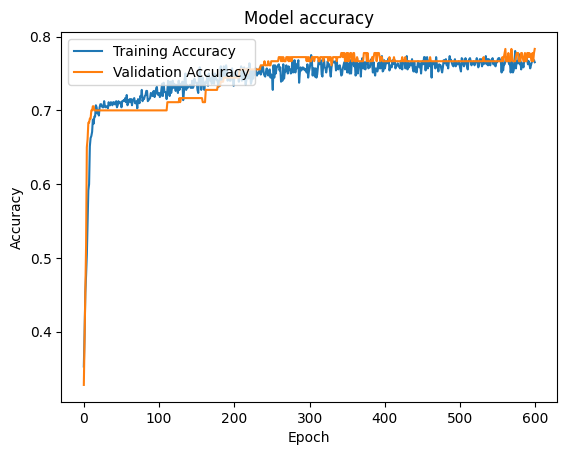

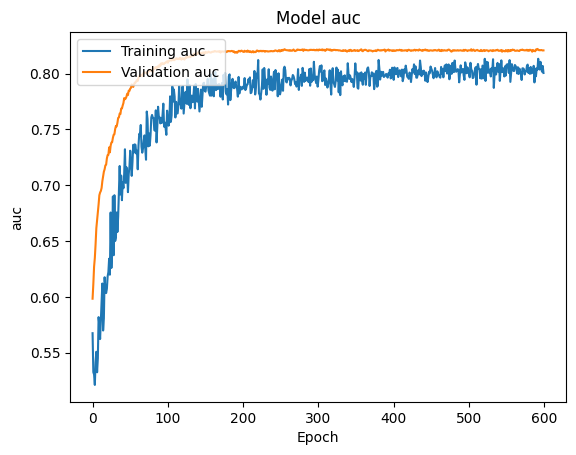

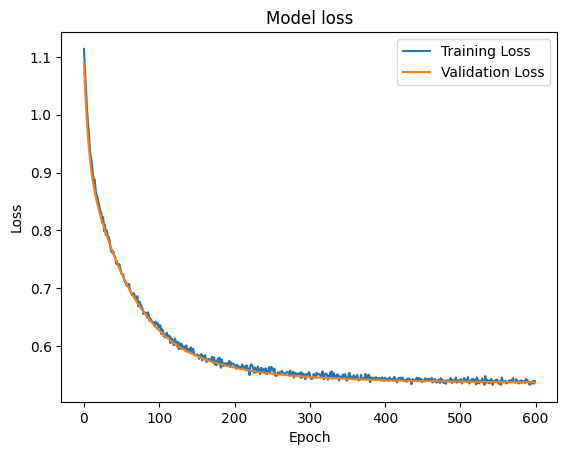

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 26s 1s/step - accuracy: 0.3750 - auc: 0.7450 - balanced_accuracy: 0.5069 - f1_score: 0.8413 - loss: 1.4426 - precision: 0.7778
Epoch 1: val_loss improved from inf to 1.34605, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 20ms/step - accuracy: 0.4656 - auc: 0.6060 - balanced_accuracy: 0.5079 - f1_score: 0.8413 - loss: 1.3774 - precision: 0.7566 - val_accuracy: 0.3000 - val_auc: 0.3755 - val_balanced_accuracy: 0.5000 - val_f1_score: 0.8413 - val_loss: 1.3460 - val_precision: 0.5000
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.4375 - auc: 0.5266 - balanced_accuracy: 0.5000 - f1_score: 0.8413 - loss: 1.3583 - precision: 0.7778
Epoch 2: val_loss improved from 1.34605 to 1.31721, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.4473 - auc: 0.5032 - balanced_accuracy: 0.5012 - f1_score: 0.8413 - loss: 1.3475 - precision: 0.7083 - val_accuracy: 0.3333 - val_au

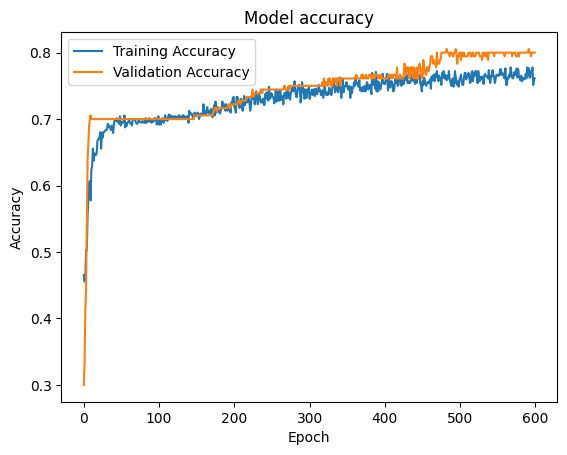

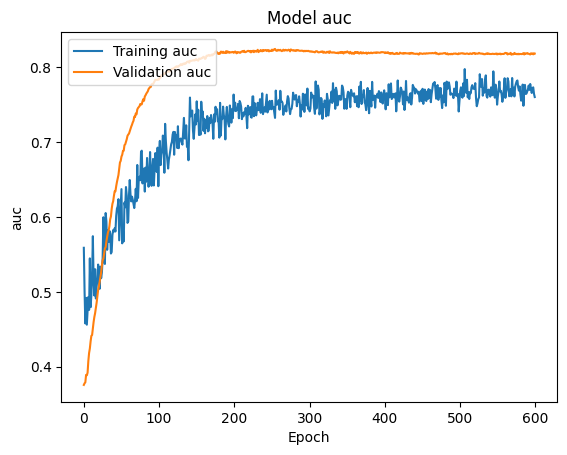

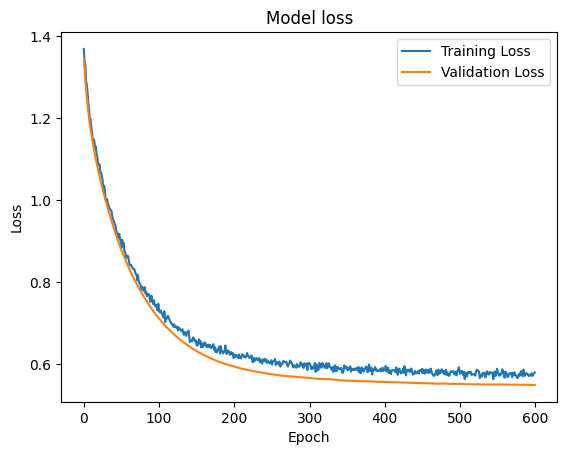

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 21s 980ms/step - accuracy: 0.7500 - auc: 0.7900 - balanced_accuracy: 0.5057 - f1_score: 0.8411 - loss: 0.8812 - precision: 0.7901
Epoch 1: val_loss improved from inf to 0.90588, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.7002 - auc: 0.6353 - balanced_accuracy: 0.5024 - f1_score: 0.8411 - loss: 0.9041 - precision: 0.7449 - val_accuracy: 0.6722 - val_auc: 0.4685 - val_balanced_accuracy: 0.4942 - val_f1_score: 0.8411 - val_loss: 0.9059 - val_precision: 0.6936
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.6562 - auc: 0.4727 - balanced_accuracy: 0.5000 - f1_score: 0.8411 - loss: 0.9042 - precision: 0.6774
Epoch 2: val_loss improved from 0.90588 to 0.89597, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.6863 - auc: 0.4814 - balanced_accuracy: 0.5017 - f1_score: 0.8411 - loss: 0.8985 - precision: 0.7029 - val_accuracy: 0.6944 - val

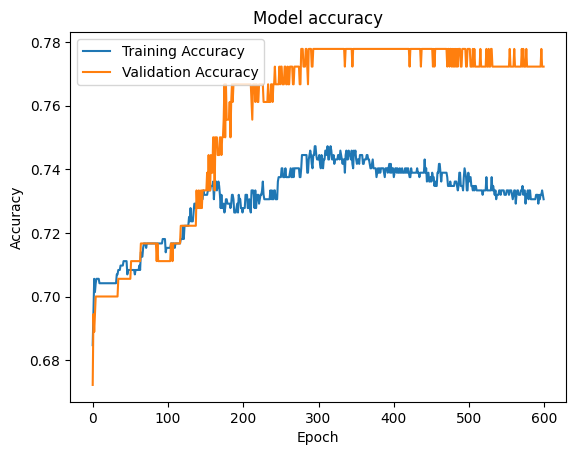

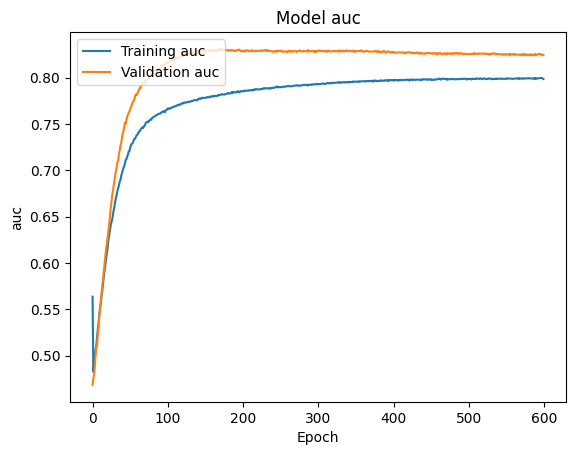

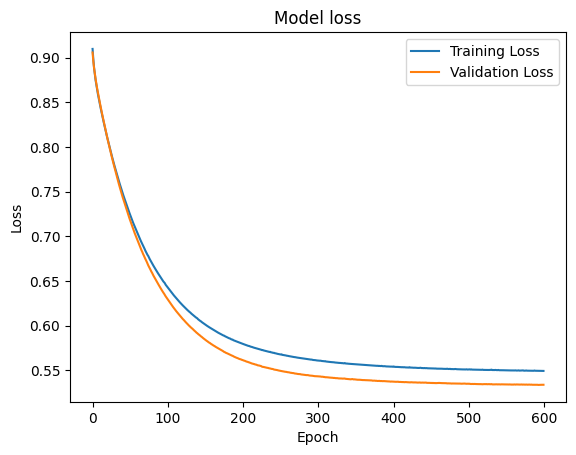

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 27s 1s/step - accuracy: 0.5312 - auc: 0.7712 - balanced_accuracy: 0.5043 - f1_score: 0.8410 - loss: 0.9871 - precision: 0.7657
Epoch 1: val_loss improved from inf to 0.90547, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 21ms/step - accuracy: 0.5407 - auc: 0.5891 - balanced_accuracy: 0.4992 - f1_score: 0.8410 - loss: 0.9786 - precision: 0.7271 - val_accuracy: 0.6611 - val_auc: 0.4462 - val_balanced_accuracy: 0.4989 - val_f1_score: 0.8410 - val_loss: 0.9055 - val_precision: 0.6901
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.5625 - auc: 0.3477 - balanced_accuracy: 0.5000 - f1_score: 0.8410 - loss: 0.9711 - precision: 0.6538
Epoch 2: val_loss improved from 0.90547 to 0.88937, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6039 - auc: 0.4898 - balanced_accuracy: 0.4988 - f1_score: 0.8410 - loss: 0.9196 - precision: 0.7328 - val_accuracy: 0.6944 - val_au

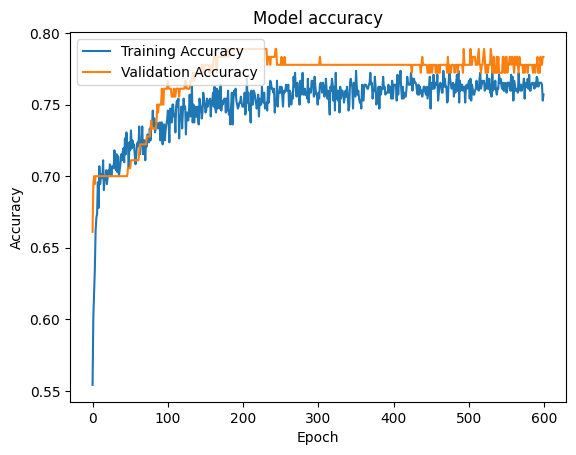

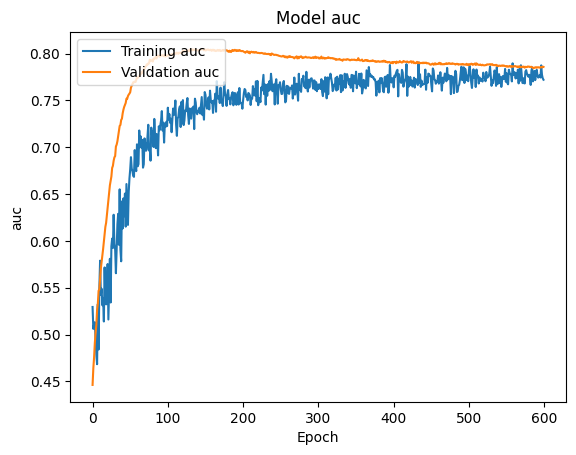

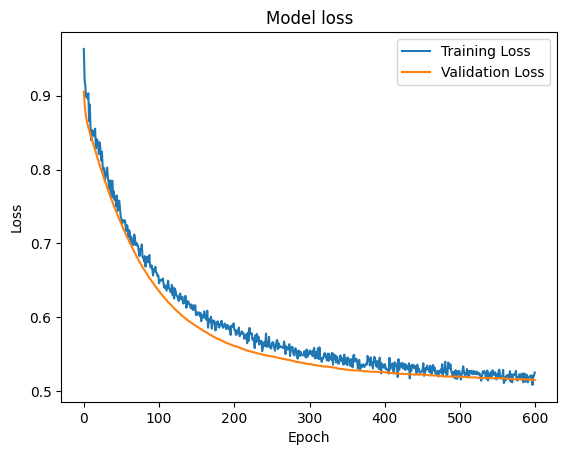

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step 
Averaging Probabilities Accuracy: 0.74
Averaging Probabilities AUC: 0.7242857142857143
Averaging Probabilities F1 Score: 0.8266666666666667


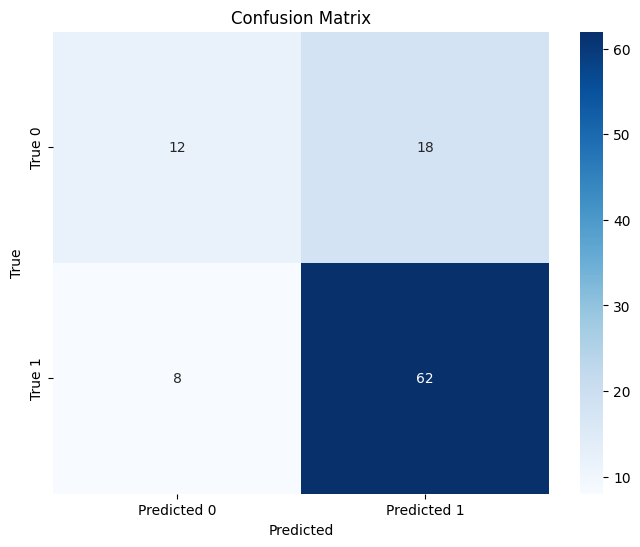

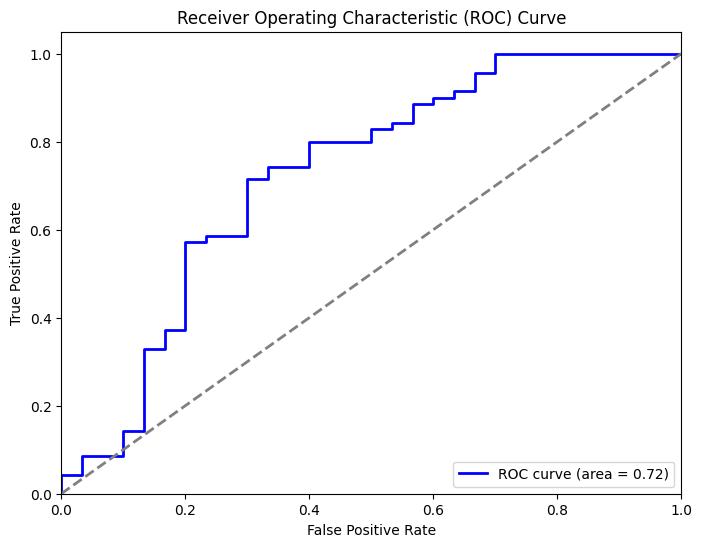

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 24s 1s/step - accuracy: 0.3125 - auc: 0.7408 - balanced_accuracy: 0.5091 - f1_score: 0.8410 - loss: 1.1524 - precision: 0.7843
Epoch 1: val_loss improved from inf to 1.13534, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - accuracy: 0.3172 - auc: 0.5923 - balanced_accuracy: 0.5005 - f1_score: 0.8410 - loss: 1.1862 - precision: 0.7758 - val_accuracy: 0.3056 - val_auc: 0.5517 - val_balanced_accuracy: 0.5006 - val_f1_score: 0.8410 - val_loss: 1.1353 - val_precision: 1.0000
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.2500 - auc: 0.3477 - balanced_accuracy: 0.5000 - f1_score: 0.8410 - loss: 1.1894 - precision: 0.2500
Epoch 2: val_loss improved from 1.13534 to 1.09625, saving model to model\best_model_04_0.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.3412 - auc: 0.5327 - balanced_accuracy: 0.4994 - f1_score: 0.8410 - loss: 1.1427 - precision: 0.6628 - val_accuracy: 0.3278 - val_au

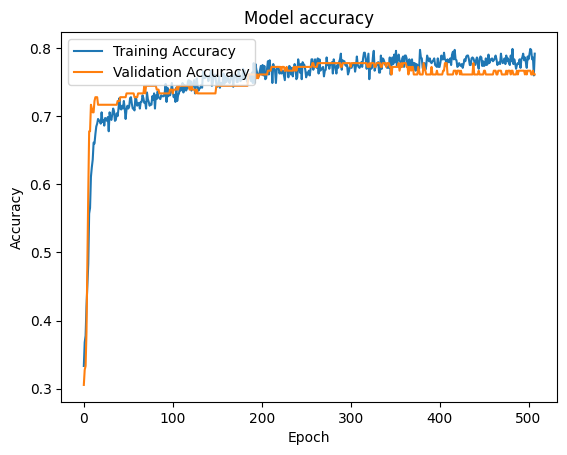

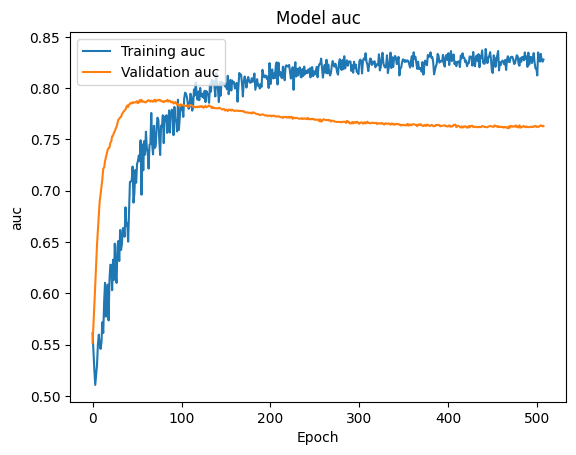

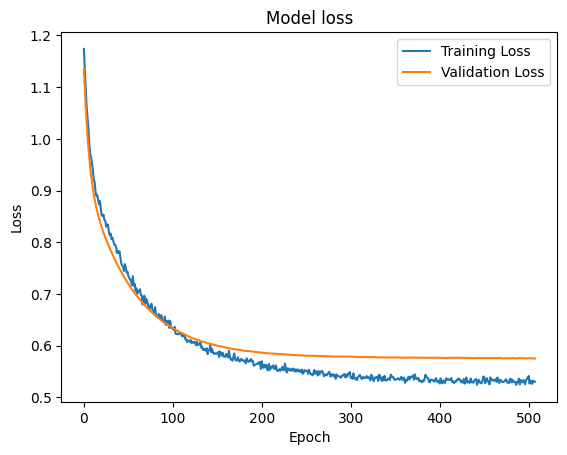

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 32s 1s/step - accuracy: 0.6875 - auc: 0.7404 - balanced_accuracy: 0.5133 - f1_score: 0.8410 - loss: 1.1935 - precision: 0.7709
Epoch 1: val_loss improved from inf to 1.19719, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 22ms/step - accuracy: 0.6699 - auc: 0.6514 - balanced_accuracy: 0.5046 - f1_score: 0.8410 - loss: 1.2271 - precision: 0.7186 - val_accuracy: 0.7000 - val_auc: 0.6252 - val_balanced_accuracy: 0.5000 - val_f1_score: 0.8410 - val_loss: 1.1972 - val_precision: 0.7000
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.7188 - auc: 0.4614 - balanced_accuracy: 0.5000 - f1_score: 0.8410 - loss: 1.2343 - precision: 0.7097
Epoch 2: val_loss improved from 1.19719 to 1.18628, saving model to model\best_model_04_1.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.6833 - auc: 0.5479 - balanced_accuracy: 0.4988 - f1_score: 0.8410 - loss: 1.2214 - precision: 0.6896 - val_accuracy: 0.7000 - val_au

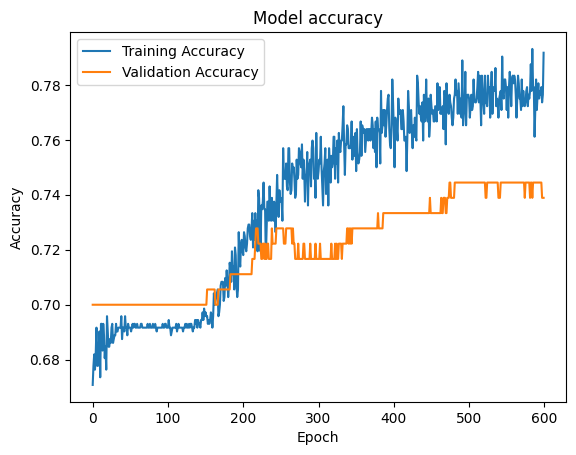

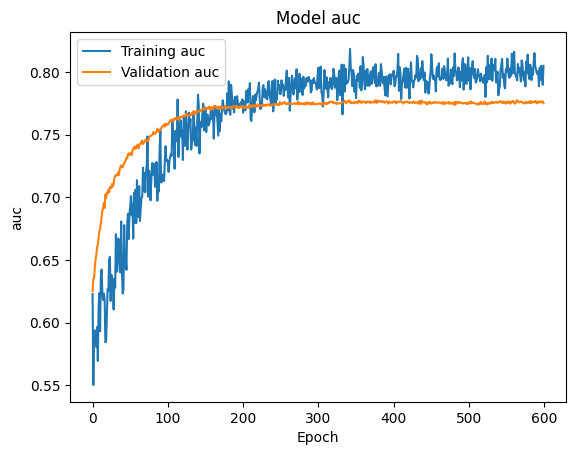

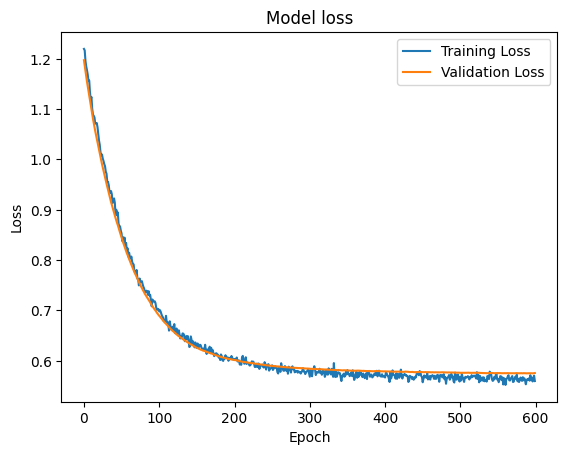

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 23s 1s/step - accuracy: 0.7188 - auc: 0.7655 - balanced_accuracy: 0.5073 - f1_score: 0.8409 - loss: 0.8376 - precision: 0.7527
Epoch 1: val_loss improved from inf to 0.82532, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 56ms/step - accuracy: 0.6951 - auc: 0.7227 - balanced_accuracy: 0.5066 - f1_score: 0.8409 - loss: 0.8431 - precision: 0.7353 - val_accuracy: 0.7278 - val_auc: 0.7472 - val_balanced_accuracy: 0.5048 - val_f1_score: 0.8409 - val_loss: 0.8253 - val_precision: 0.7305
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.8125 - auc: 0.8045 - balanced_accuracy: 0.5000 - f1_score: 0.8409 - loss: 0.7735 - precision: 0.8125
Epoch 2: val_loss improved from 0.82532 to 0.81765, saving model to model\best_model_04_2.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.7029 - auc: 0.6933 - balanced_accuracy: 0.5014 - f1_score: 0.8409 - loss: 0.8359 - precision: 0.7186 - val_accuracy: 0.7389 - val_au

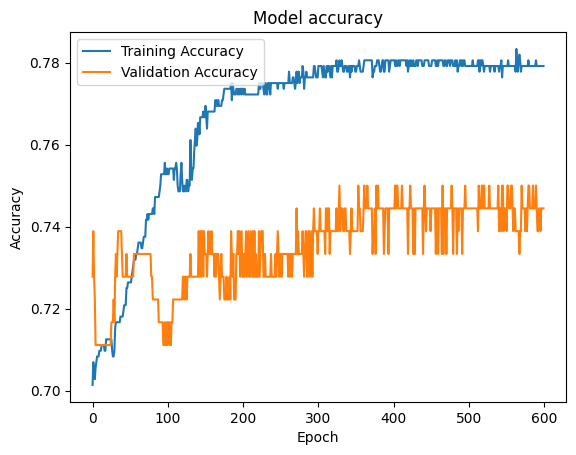

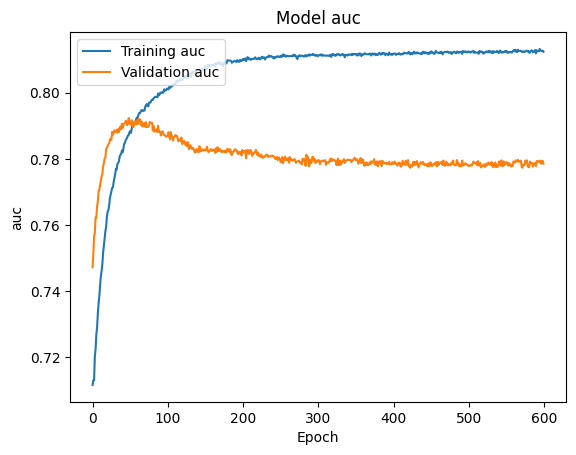

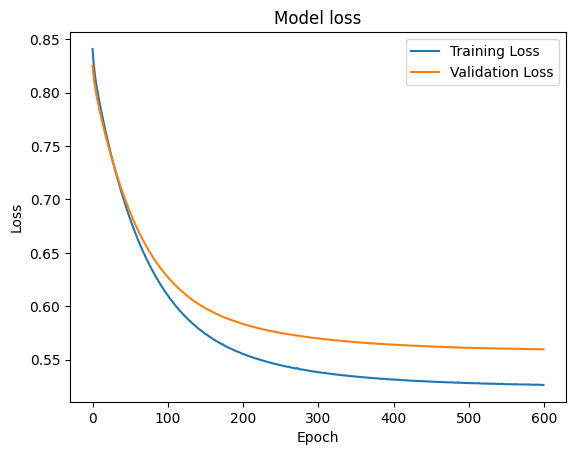

Epoch 1/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 26s 1s/step - accuracy: 0.6250 - auc: 0.7444 - balanced_accuracy: 0.5061 - f1_score: 0.8411 - loss: 0.9083 - precision: 0.7630
Epoch 1: val_loss improved from inf to 0.90736, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.5224 - auc: 0.5973 - balanced_accuracy: 0.5037 - f1_score: 0.8411 - loss: 0.9570 - precision: 0.7301 - val_accuracy: 0.6444 - val_auc: 0.5436 - val_balanced_accuracy: 0.5105 - val_f1_score: 0.8411 - val_loss: 0.9074 - val_precision: 0.7246
Epoch 2/600
 1/23 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - accuracy: 0.4688 - auc: 0.4740 - balanced_accuracy: 0.5000 - f1_score: 0.8411 - loss: 0.9700 - precision: 0.7333
Epoch 2: val_loss improved from 0.90736 to 0.88485, saving model to model\best_model_04_3.keras
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step - accuracy: 0.5627 - auc: 0.5492 - balanced_accuracy: 0.5014 - f1_score: 0.8411 - loss: 0.9199 - precision: 0.7265 - val_accuracy: 0.7000 - val_au

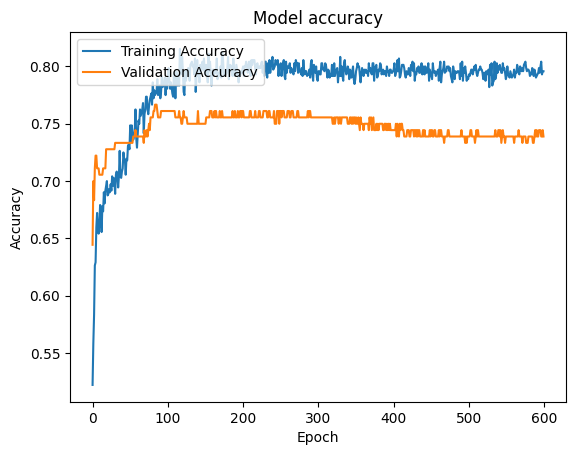

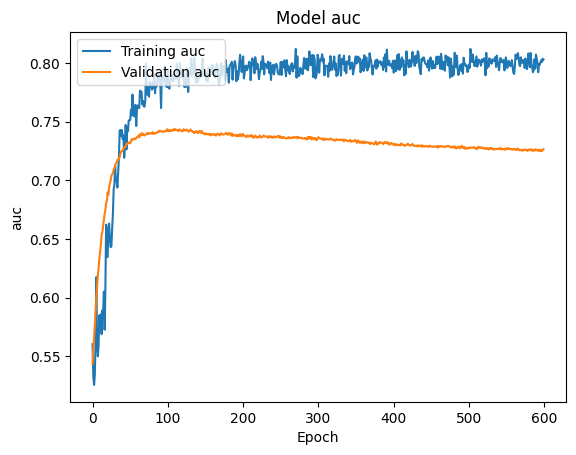

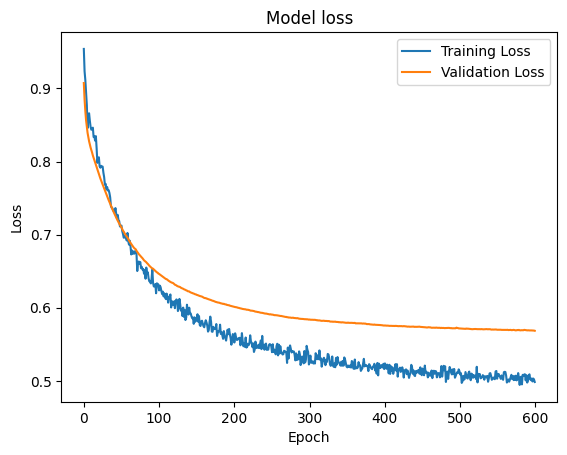

4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step 
Averaging Probabilities Accuracy: 0.78
Averaging Probabilities AUC: 0.7899999999999999
Averaging Probabilities F1 Score: 0.855263157894737


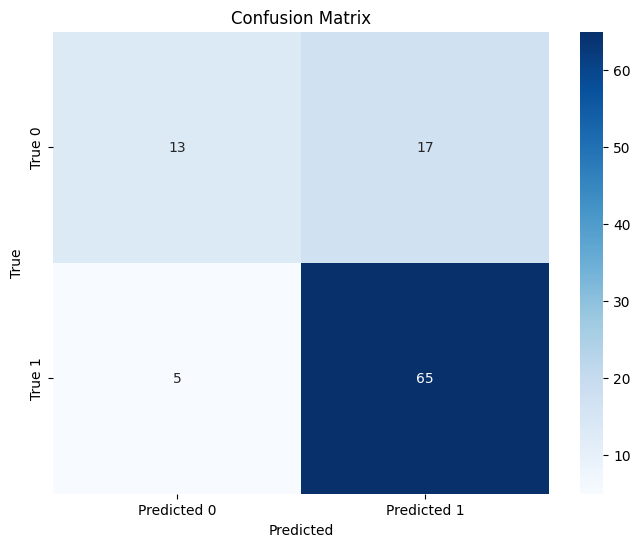

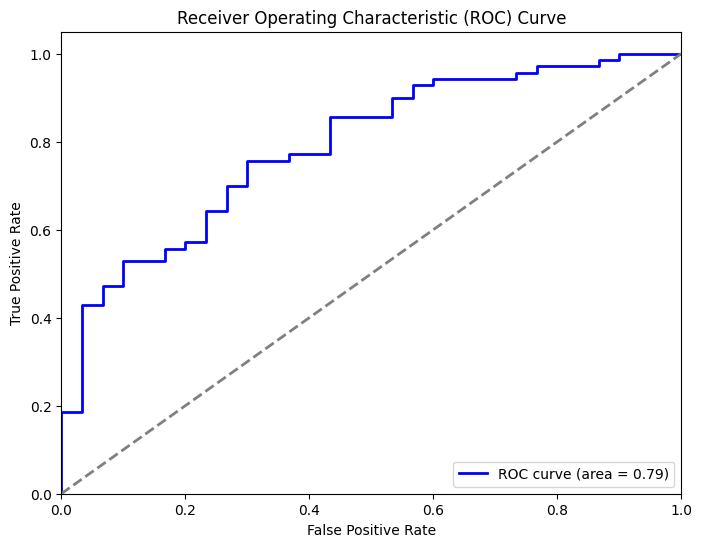

In [8]:
adasyn = ADASYN(random_state=42)

kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=69)

# Initialize metrics lists
accuracies = []
# precisions = []
# recalls = []
f1_scores = []
roc_aucs = []
# true_negatives = []
# balance_accuracies = []

# Perform KFold cross-validation
for train_index, test_index in kf.split(t_X, Y):
    X_train, X_test = t_X[train_index], t_X[test_index]
    y_train, y_test = Y[train_index], Y[test_index]

    X_split, X_val, y_split, y_val = train_test_split(X_train, y_train, test_size=0.2, stratify=y_train, random_state=200)


    base_model_num = 4

    adams = [keras.optimizers.Adam(learning_rate=0.0001), keras.optimizers.Adam(learning_rate=0.0001), keras.optimizers.Adam(learning_rate=0.0001), keras.optimizers.Adam(learning_rate=0.0001)]

    models = [Set_model.model1(optimizer=adams[0], metric=metrics, loss=loss), Set_model.model2(optimizer=adams[1], metric=metrics, loss=loss), 
              Set_model.model3(optimizer=adams[2], metric=metrics, loss=loss), Set_model.model4(optimizer=adams[3], metric=metrics, loss=loss)]

    best_models = []

    X_samples, y_samples = sampling.create_bootstrap_samples(X_split, y_split, base_model_num)

    for i in range((base_model_num)):

        early_stopping = keras.callbacks.EarlyStopping(
        monitor="val_loss",
        min_delta=0.001,
        patience=100,
        verbose=1,
        mode="min",
        )

        checkpoint = keras.callbacks.ModelCheckpoint(
        filepath = f'model\\best_model_04_{i}.keras',
        monitor= "val_loss",
        verbose=1,
        mode="min",
        save_best_only=True,  # Save only the best model based on the monitored metric
        save_weights_only=False,  # Save the full model (set to True to save only the weights)
        save_freq='epoch'  # Save the model at the end of every epoch
        )

        history = models[i].fit(X_samples[i], y_samples[i], epochs=600, validation_data=(X_val, y_val), callbacks = [early_stopping, checkpoint])

        best_model = load_model(f'model\\best_model_04_{i}.keras')

        loss_and_metrics = best_model.evaluate( X_test, y_test)
        print(loss_and_metrics)
        print('Loss = ',loss_and_metrics[0])

        plot.plotAccuracy(history)
        plot.plotAUC(history)
        plot.plotLoss(history)

        best_models.append(best_model)

    # Make predictions with each model
    predictions = np.zeros((X_test.shape[0], len(best_models)))
    for i, model in enumerate(best_models):
        predictions[:, i] = model.predict(X_test).flatten()

    # Averaging probabilities
    average_probabilities = np.mean(predictions, axis=1)
    final_predictions_average = (average_probabilities > 0.5).astype(int)
    accuracy_average = accuracy_score(y_test, final_predictions_average)
    auc_average = roc_auc_score(y_test, average_probabilities)
    f1_average = f1_score(y_test, final_predictions_average)

    print(f'Averaging Probabilities Accuracy: {accuracy_average}')
    print(f'Averaging Probabilities AUC: {auc_average}')
    print(f'Averaging Probabilities F1 Score: {f1_average}')

    accuracies.append(accuracy_average)
    f1_scores.append(f1_average)
    roc_aucs.append(auc_average)

    # Confusion Matrix
    conf_matrix = confusion_matrix(y_test, final_predictions_average)

    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Predicted 0', 'Predicted 1'], yticklabels=['True 0', 'True 1'])
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

    # ROC Curve
    fpr, tpr, _ = roc_curve(y_test, average_probabilities)
    roc_auc = auc(fpr, tpr)

    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='gray', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc='lower right')
    plt.show()

# Display the metrics
print(f"Average Accuracy: {np.mean(accuracies)}")
print("Standard Deviation of CV accuracy: ", np.std(accuracies))
print(f"Average F1-Score: {np.mean(f1_scores)}")
print("Standard Deviation of CV F1: ", np.std(f1_scores))
print(f"Average ROC-AUC: {np.mean(roc_aucs)}")
print("Standard Deviation of CV roc_auc: ", np.std(roc_aucs))